In [4]:
import pandas as pd
import os
import urllib

# Download the data

If `wget` is not installed on your machine, you may want to try `curl URL > file.txt` or the `urllib` package in python.

In [ ]:
%%bash
mkdir data_ghcn
cd data_ghcn
wget https://www1.ncdc.noaa.gov/pub/data/ghcn/daily/ghcnd-stations.txt
wget https://www1.ncdc.noaa.gov/pub/data/ghcn/daily/by_year/2021.csv.gz
gzip -d 2021.csv.gz

--2022-11-09 21:46:06--  https://www1.ncdc.noaa.gov/pub/data/ghcn/daily/ghcnd-stations.txt
Resolving www1.ncdc.noaa.gov (www1.ncdc.noaa.gov)... 205.167.25.177, 205.167.25.172, 205.167.25.168, ...
Connecting to www1.ncdc.noaa.gov (www1.ncdc.noaa.gov)|205.167.25.177|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 10593738 (10M) [text/plain]
Saving to: ‘ghcnd-stations.txt’

     0K .......... .......... .......... .......... ..........  0% 1.40M 7s
    50K .......... .......... .......... .......... ..........  0% 2.80M 5s
   100K .......... .......... .......... .......... ..........  1% 53.6M 4s
   150K .......... .......... .......... .......... ..........  1% 2.83M 4s
   200K .......... .......... .......... .......... ..........  2%  147M 3s
   250K .......... .......... .......... .......... ..........  2%  175M 2s
   300K .......... .......... .......... .......... ..........  3% 2.99M 2s
   350K .......... .......... .......... .......... ..........  3%  

# Data Preprocessing

In [2]:
def get_vals(line):
    ls = line.split(',')
    station = ls[0]
    time = ls[1]
    val = float(ls[3])
    return [station, time, val]

def get_stations(filename='data_ghcn/ghcnd-stations.txt'):
    df = pd.read_csv(filename, '/t', header=None)
    df = df[0].str.split(expand=True)[[0, 1, 2, 3]]
    df.columns = ['Station', 'Latitude', 'Longitude', 'Elevation']
    return df

def process_year(year, stations, col='TAVG', basedir='data_ghcn'):
    tavg = []
    with open(os.path.join(basedir, "%s.csv" % year)) as h:
        l = h.readline()
        while l:
            if col in l:
                v = get_vals(l)
                if stations['Station'].str.contains(v[0]).any():
                    tavg.append(get_vals(l))
            l = h.readline()
    df_tavg = pd.DataFrame(tavg, columns=['Station', 'Date', col])
    df_merged = df_tavg.merge(stations, left_on='Station', right_on='Station', how='left')
    df_merged['Date'] = df_merged['Date'].apply(pd.Timestamp)
    for c in ['Latitude', 'Longitude', col, 'Elevation']:
        df_merged[c] = df_merged[c].astype(float)
    return df_merged[['Station', 'Date', col, 'Latitude', 'Longitude', 'Elevation']]

In [ ]:
stations = get_stations()
df1 = process_year('2021', stations, col='TAVG')
stations = stations[stations.Station.isin(df1.Station)]

In [ ]:
df2 = process_year('2021', stations, col='PRCP')

In [ ]:
df = df1.merge(df2[['Station', 'Date', 'PRCP']], on=['Station', 'Date'])
# df.to_csv('data_ghcn/daily_global_weather_2020.csv')


In [9]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import punch_party_utils

Let's view the first few columns of each dataframe to see what we are working with

In [10]:
gas_types = punch_party_utils.make_gas_types_df(silent=False)

gas_types.head():


,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,Year,Zip Code,Facility Name
0,1919 S. BROADWAY,GREEN BAY,58024.000,BROWN,1000589,BIOCO2,BIOGENIC CO2,44.492500,-88.032300,WISCONSIN,2017,54304,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC
1,850 12TH AVE,NEW YORK,134.500,NEW,1000766,CH4,METHANE,40.771100,-73.991100,NEW YORK,2018,10019,59TH STREET
2,3379 HWY 482,NOBLE,6.854,SABINE,1009343,N2O,NITROUS OXIDE,31.621528,-93.724774,LOUISIANA,2012,71462,BAKER ROAD TREATER
3,1012 BEAUCHAMP ST,GREENVILLE,53562.000,WASHINGTON,1003557,CH4,METHANE,33.392476,-91.017584,MISSISSIPPI,2017,38701,TEXAS GAS TRANSMISSION - GREENVILLE STATION
4,487 CORN CREEK ROAD,BEDFORD,7635064.700,TRIMBLE,1006542,CO2,CARBON DIOXIDE,38.584700,-85.411700,KENTUCKY,2018,40006,TRIMBLE COUNTY


The gas_type dataframe contains data about the location of emitter facilities and gas types emitted from each one. There are ~220,000 entries.

In [12]:
air_quality = punch_party_utils.make_air_quality_df(silent=False)
air_quality.head()

air_quality.head():


,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
0,83,Number of days with maximum 8-hour average ozo...,Counts,State x County,1,ALABAMA,1027,CLAY,1999,33.0,No Units,No Units,Monitor Only,1
1,83,Number of days with maximum 8-hour average ozo...,Counts,State x County,1,ALABAMA,1051,ELMORE,1999,5.0,No Units,No Units,Monitor Only,1
2,83,Number of days with maximum 8-hour average ozo...,Counts,State x County,1,ALABAMA,1073,JEFFERSON,1999,39.0,No Units,No Units,Monitor Only,1
3,83,Number of days with maximum 8-hour average ozo...,Counts,State x County,1,ALABAMA,1079,LAWRENCE,1999,28.0,No Units,No Units,Monitor Only,1
4,83,Number of days with maximum 8-hour average ozo...,Counts,State x County,1,ALABAMA,1089,MADISON,1999,31.0,No Units,No Units,Monitor Only,1


The air_quality dataframe contains air quality measures across different states/counties in the United States. It contains over 218,000 entries.

In [14]:
facilities = punch_party_utils.make_facilities_df()
facilities.head()

/home/pfromm/data200s/TeamPunchParty/punch_party_utils.py:19: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  facilities_df = pd.read_csv(filename)


,Address Line 1,Address Line 2,CEMS Used,City,County,FIPS,Facilities ID,Latitude,Longitude,NAICS Code,...,State Name,Year,Zip Code,Facility Name,Secondary NAICS Code,Additional NAICS Codes,Cogeneration Unit Emission Index(?),EPA Verified,Parent Company,Plant Code Indicator
0,301 COMMERCE DR. SUITE 3701,NaN,NaN,Fort Worth,NaN,NaN,1008536.0,35.533760,-97.529760,211111.0,...,TEXAS,2012.0,76102.0,TEP Barnett USA LLC 415 - Strawn Basin,NaN,NaN,N,NaN,CHESAPEAKE ENERGY CORP (100%),NaN
1,449 SHELL E&P COURT,NaN,NaN,Gibson,TERREBONNE,22109.0,1005071.0,29.628790,-90.917680,211112.0,...,LOUISIANA,2011.0,70358.0,North Terrebonne Gas Plant,NaN,NaN,N,NaN,ENTERPRISE GAS PROCESSING LLC (64.19%); DCP M...,NaN
2,5494 MALONE ROAD,NaN,NaN,MEMPHIS,SHELBY COUNTY,47157.0,1002466.0,34.999213,-89.906724,562212.0,...,TENNESSEE,2017.0,38116.0,SOUTH SHELBY LANDFILL,NaN,NaN,N,NaN,REPUBLIC SERVICES INC (100%),N
3,1601 WEEDON ISLAND DRIVE,NaN,NaN,SAINT PETERSBURG,Pinellas,12103.0,1001489.0,27.861300,-82.601200,221112.0,...,FLORIDA,2015.0,33702.0,P L Bartow Power Plant,NaN,NaN,N,NaN,DUKE ENERGY CORP (100%),Y
5,2237 HATCHER HILL RD,NaN,NaN,BACONTON,Mitchell,13205.0,1001409.0,31.386900,-84.081900,221112.0,...,GEORGIA,2011.0,31716.0,Baconton,NaN,NaN,N,NaN,SOWEGA ENERGY RESOURCES LLC. (65%); TEJAS POW...,NaN


The facilities dataframe contains data about each facility, namely address, location, and IDs (FIPS, NAICS). There are ~77,000 rows.

# Question a 
## How does air quality relate to the number of emitting facilities and and level of emissions in the area?
We can answer this question using the air_quality and gas_types dataframes. There are a few things we need to choose first:
- what year we will use
- which air quality measure type to use

In [6]:
# air quality rows where 'MeasureType' is average

aq_avg = punch_party_utils.make_average_aq_df()

The air quality dataframe has data from the years 1999 - 2013 while gas_types has data from 2010 - 2019. Let's use the year 2011 since both have a good amount of data for this year.

In [6]:
# UNCOMMENT CODE BELOW TO SEE NUM ENTRIES FOR EACH YEAR
#gas_types['Year'].value_counts()
#aq_avg['ReportYear'].value_counts()

Now let's find the number of facilities in a county in a given year and put that data together. Below is a trial run. Following a successful trial run, I put the following code into a for loop to do the same for every state and county in 2011.

In [7]:
# air_quality rows where Weston is the county and year is 2011
weston_aq_2011 = aq_avg[(aq_avg['CountyName'] == 'WESTON') & (aq_avg['ReportYear'] == 2011) & (aq_avg['StateName'] == 'WYOMING')]

# gas_types rows where Weston is county and year is 2011
weston_gas_2011 = gas_types[(gas_types['County'] == 'WESTON') & (gas_types['Year'] == 2011)]
# get number of facilities in that county and year
num_weston_facilities = weston_gas_2011['Facility'].nunique()

# add number of facilities column to weston_aq
#weston_aq['NumFacilities'] = num_weston_facilities
weston_aq_and_facilities = weston_aq_2011.assign(NumFacilities= num_weston_facilities)
weston_aq_and_facilities

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
218634,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,WYOMING,56045,WESTON,2011,6.646464,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,3


## ATTENTION
Do not run the cell below. It takes ~3.5 hours to produce the resulting dataframe. The code remains here for the sake of documentation and its output can be found in the file 'county-airq-num-facilities-with-none.csv'

In [13]:

# create an empty DataFrame to store the results: air quality
county_aq_with_facilities = pd.DataFrame()

# get unique counties and states from the aq_avg
counties = aq_avg['CountyName'].unique()
states = aq_avg['StateName'].unique()

# iterate through each combination of county and state
for county in counties:
    for state in states:
        # filter 'aq_avg' for current county and state in 2011
        county_aq_2011 = aq_avg[(aq_avg['CountyName'] == county) & (aq_avg['StateName'] == state) & (aq_avg['ReportYear'] == 2011)]

        # filter 'gas_types' for the current county and state in 2011
        county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
        # get the number of unique facilities for the current county and state in 2011
        num_facilities = county_gas_2011['Facility Name'].nunique()

        # add number of facilities column to county_aq_data
        county_aq_and_facilities_entry = county_aq_2011.assign(NumFacilities= num_facilities)

        # create a new row for the resulting dataframe with the county, state, and number of facilities
        county_aq_with_facilities = pd.concat([county_aq_with_facilities, county_aq_and_facilities_entry], ignore_index=True)
# Display the result DataFrame
county_aq_with_facilities.head()

/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  county_gas_2011 = gas_types[(aq_avg['CountyName'] == county) & (gas_types['State Name'] == state) & (gas_types['Year'] == 2011)]
/var/folders/m8/skfw9g2x4_g4pq5cv80_g24w0000gn/T/ipykernel_77440/2374596677.py:15: UserWarning: Boolean Series key will be reindex

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
0,87,Annual average ambient concentrations of PM2.5...,Average,State x County,54,WEST VIRGINIA,54081,RALEIGH,2011,9.170170,µg/m³,Micograms per cubic meter,Monitor Only,1,0
1,296,Annual average ambient concentrations of PM 2....,Average,State x County,54,WEST VIRGINIA,54081,RALEIGH,2011,9.455357,µg/m³,Micograms per cubic meter,Monitor Only,1,0
2,87,Annual average ambient concentrations of PM2.5...,Average,State x County,12,FLORIDA,12033,ESCAMBIA,2011,9.473017,µg/m³,Micograms per cubic meter,Monitor Only,1,0
3,296,Annual average ambient concentrations of PM 2....,Average,State x County,12,FLORIDA,12033,ESCAMBIA,2011,9.611908,µg/m³,Micograms per cubic meter,Monitor Only,1,0
4,296,Annual average ambient concentrations of PM 2....,Average,State x County,1,ALABAMA,1053,ESCAMBIA,2011,9.604895,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,0


In [7]:
# save dataframe to a CSV file. Obviously this cell won't work sinde you didnt run the above cell.
# county_aq_with_facilities.to_csv('county-airq-num-facilities-with-none.csv', index=False)

There are some state/county combos for which we have air quality data but no facility data. NumFacilities is 0 for these states/counties.

In [16]:
county_aq_with_facilities_with_none = pd.read_csv('county-airq-num-facilities-with-none.csv')
county_aq_with_facilities_with_none.head()

print(f'The number of non-zero values in the NumFacilities column is {len(county_aq_with_facilities_with_none) - county_aq_with_facilities_with_none["NumFacilities"].eq(0).sum()}.')

The number of non-zero values in the NumFacilities column is 424.


Of the 3634 rows in county_aq_with_facilities, only 424 of them have non-zero values for NumFacilities. Maybe can use our generative model to predict the number of facilities in some of these places based on air quality value. For now, let's remove these values so we can plot air quality vs num facilities and air quality vs emission value

In [18]:
# county_aq_with_facilities = county_aq_with_facilities_with_none[county_aq_with_facilities_with_none['NumFacilities'] != 0]
# county_aq_with_facilities.head()

# save to CSV as well. This also won't work anymore, but is here to document what was done
#county_aq_with_facilities.to_csv('county-airq-num-facilities.csv', index=False)

The next time this notebook was loaded, county_aq_with_facilities was read from the CSV it was saved to last time

In [16]:
# read from csv to continue working
county_aq_with_facilities = pd.read_csv('csv_data/county-airq-num-facilities.csv')

county_aq_with_facilities.head()

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly,NumFacilities
0,296,Annual average ambient concentrations of PM 2....,Average,State x County,54,WEST VIRGINIA,54037,JEFFERSON,2011,10.382477,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,2
1,296,Annual average ambient concentrations of PM 2....,Average,State x County,29,MISSOURI,29099,JEFFERSON,2011,11.974413,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,1
2,296,Annual average ambient concentrations of PM 2....,Average,State x County,19,IOWA,19101,JEFFERSON,2011,10.343955,µg/m³,Micograms per cubic meter,Monitor & Modeled,0,1
3,87,Annual average ambient concentrations of PM2.5...,Average,State x County,39,OHIO,39081,JEFFERSON,2011,12.602603,µg/m³,Micograms per cubic meter,Monitor Only,1,1
4,296,Annual average ambient concentrations of PM 2....,Average,State x County,39,OHIO,39081,JEFFERSON,2011,12.557897,µg/m³,Micograms per cubic meter,Monitor Only,1,1


Finally, let's make a scatter plot to visualize the relationship between number of facilities and air quality measure values.

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


<Axes: xlabel='NumFacilities', ylabel='Value'>

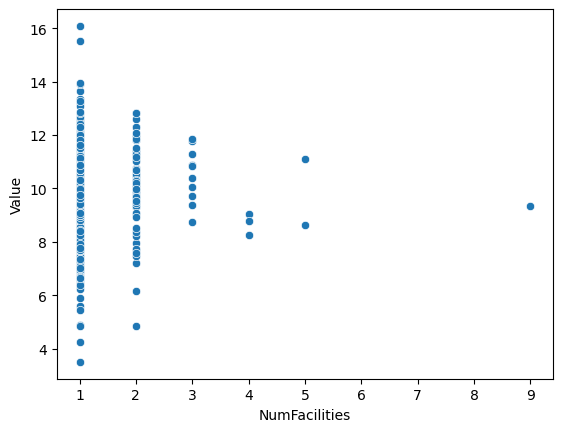

In [36]:
sns.scatterplot(x = "NumFacilities", y = "Value", data=county_aq_with_facilities)

In [22]:
county_aq_with_facilities['StateName'].value_counts()

StateName
OHIO              40
TEXAS             40
ILLINOIS          27
GEORGIA           20
KENTUCKY          19
PENNSYLVANIA      18
NEW YORK          17
MISSOURI          17
LOUISIANA         17
INDIANA           17
IOWA              15
NORTH CAROLINA    13
CALIFORNIA        13
TENNESSEE         13
MICHIGAN          13
ARKANSAS          10
MISSISSIPPI       10
FLORIDA            9
ALABAMA            9
COLORADO           8
VIRGINIA           8
WISCONSIN          8
KANSAS             8
NEW JERSEY         6
WEST VIRGINIA      6
MINNESOTA          6
NEBRASKA           5
SOUTH DAKOTA       5
OKLAHOMA           4
WASHINGTON         4
OREGON             3
SOUTH CAROLINA     3
MAINE              3
NEW HAMPSHIRE      2
DELAWARE           2
NORTH DAKOTA       2
NEVADA             1
NEW MEXICO         1
IDAHO              1
MARYLAND           1
Name: count, dtype: int64

# Question c
## Is there a gas type associated with especially bad AQ measures?
We can answer this question using the air_quality and gas_types dataframes. We will use:
- aq measures from a particular gas type

In [18]:
# air quality rows where 'MeasureType' is average
# we are doing this because other measure types contain a lot of 0s
aq_avg = air_quality[air_quality['MeasureType'] == 'Average']
# rename the county column in aq_avg so they have the same name and merging is easier
aq_avg = aq_avg.rename(columns = {'CountyName': 'County'})

# I'm still suspicious about their modeled values, going monitor only for my model
# print(aq_avg["MeasureName"].unique())

aq_avg_moniter_only = aq_avg[aq_avg["MeasureName"] == "Annual average ambient concentrations of PM2.5 in micrograms per cubic meter (based on seasonal averages and daily measurement)"]

print(aq_avg_moniter_only["ReportYear"].unique())

[2003 2002 1999 2001 2006 2009 2013 2004 2007 2008 2010 2005 2000 2012
 2011]


Further reasoning for choosing 2011 mentioned further down.

The air quality dataframe has data from the years 1999 - 2013 while gas_types has data from 2010 - 2019. Let's use the year 2011 since both have a good amount of data for this year.

In [25]:
# UNCOMMENT CODE BELOW TO SEE NUM ENTRIES FOR EACH YEAR
#gas_types['Year'].value_counts()
#aq_avg['ReportYear'].value_counts()

Let's merge both dataframes based on County so we get a dataframe with both gas codes and aq values (fingers crossed)

In [26]:
gas_types_aq_avg_merged = pd.merge(gas_types, aq_avg, on='County')
gas_types_aq_avg_merged.tail()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,...,StratificationLevel,StateFips,StateName,CountyFips,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
12756642,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2007,13.248120,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756643,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2008,11.158683,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756644,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2009,9.942045,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756645,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2010,11.145043,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
12756646,5444 HWY 421,HELTON,18101.5,LESLIE,1006623,CH4,METHANE,36.982299,-83.400436,KENTUCKY,...,State x County,21,KENTUCKY,21131,2011,9.516099,µg/m³,Micograms per cubic meter,Monitor & Modeled,0


Nice! Now let's plot Values VS Gas Codes on a scatterplot to visualize any correlation between the two.

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


<Axes: xlabel='Gas Code', ylabel='Value'>

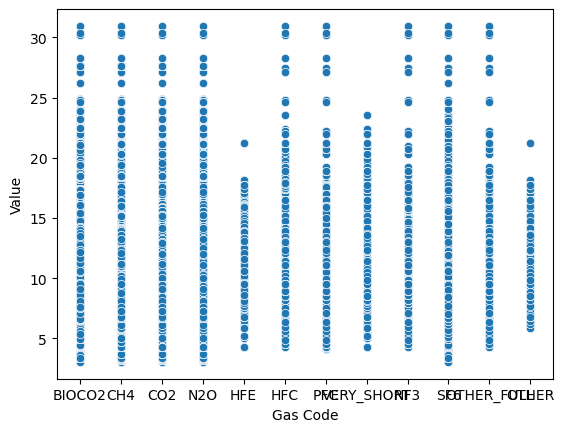

In [28]:
sns.scatterplot(x = "Gas Code", y = "Value", data=gas_types_aq_avg_merged)

Visually, the scatterplot does not show much correlation between a specific gas type and air quality values. Another way to do this would be to groupby gas type and get the average air quality value.

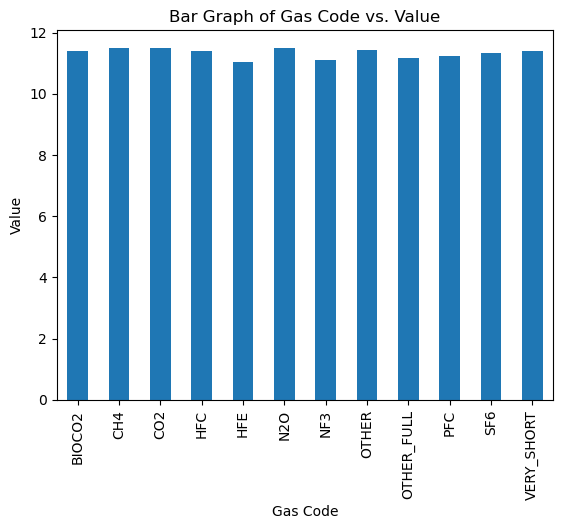

In [29]:
avg_value_by_gas_code = gas_types_aq_avg_merged.groupby('Gas Code')['Value'].mean()
# now we make bar graph
avg_value_by_gas_code.plot.bar(use_index=True)

plt.title('Bar Graph of Gas Code vs. Value')
plt.xlabel('Gas Code')
plt.ylabel('Value')
plt.show()

Average values are all around the same thing. There doesn't seem to be a correlation between an air quality value and a gas type. Tbh this question seems kinda weak (or seems like it'll be too hard to extract the data in a way that will correctly answer the question)

Now plot CO2 emission VS aq measure

/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/olukoredeogundele/miniconda3/envs/msse-python/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):


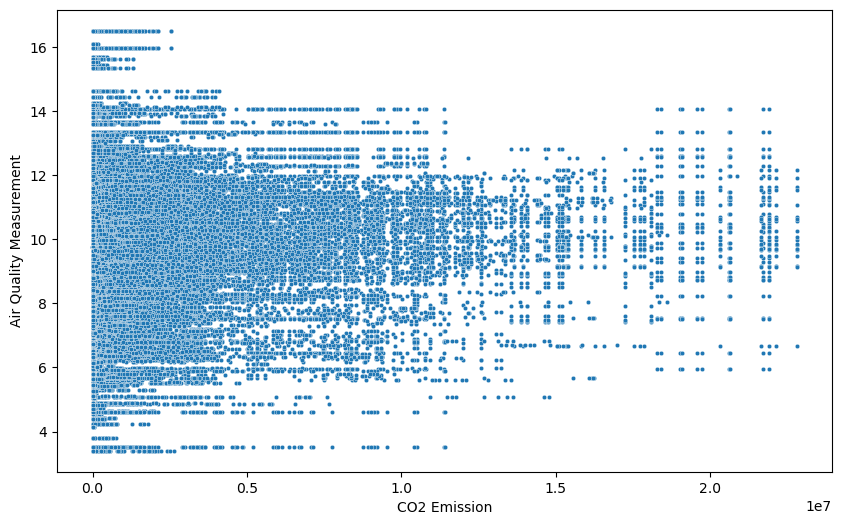

In [32]:
plt.figure(figsize=(10, 6))
gas_types_aq_avg_2011 = gas_types_aq_avg_merged[gas_types_aq_avg_merged['ReportYear'] == 2011]

sns.scatterplot(x = "CO2 Emission", y = "Value", data=gas_types_aq_avg_2011, s=10)

plt.xlabel("CO2 Emission")
plt.ylabel("Air Quality Measurement")
# plt.title("Scatterplot of CO2 Emission vs. AQ Value")
plt.show()

In [2]:
import pandas as pd

import punch_party_utils

Let's view the first few columns of each dataframe to see what we are working with

In [3]:
gas_types = pd.read_csv('us_greenhouse_gas_emission_direct_emitter_gas_type.csv')
# RENAME ALL COLUMNS SO IT'S NOT SUCH AN EYESORE
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.ADDRESS1': 'Address Line 1'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.ADDRESS2': 'Address Line 2'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.CITY': 'City'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.CO2E_EMISSION': 'CO2 Emission'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.COUNTY': 'County'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.FACILITY_ID': 'Facility ID'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.GAS_CODE': 'Gas Code'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.GAS_NAME': 'Gas Name'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.LATITUDE': 'Latitude'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.LONGITUDE': 'Longitude'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.STATE': 'State'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.STATE_NAME': 'State Name'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.YEAR': 'Year'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.ZIP': 'Zip Code'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.FACILITY_NAME': 'Facility Name'})
gas_types = gas_types.rename(columns = {'V_GHG_EMITTER_GAS.COUNTY_FIPS': 'FIPS'})
# MAKE ADDRESSES ALL UPPERCASE, THEN DROP ROWS WITH NO ADDRESS
gas_types['Address Line 1'] = gas_types['Address Line 1'].str.upper()
gas_types = gas_types.dropna(subset =['Address Line 1'] )

gas_types.head()

,Address Line 1,Address Line 2,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State,State Name,Year,Zip Code,Facility Name,FIPS
0,1919 S. BROADWAY,NaN,GREEN BAY,58024.000,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.492500,-88.032300,WI,WISCONSIN,2017,54304,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,55009.0
1,850 12TH AVE,NaN,NEW YORK,134.500,New York,1000766,CH4,Methane,40.771100,-73.991100,NY,NEW YORK,2018,10019,59th Street,36061.0
2,3379 HWY 482,NaN,Noble,6.854,SABINE,1009343,N2O,Nitrous Oxide,31.621528,-93.724774,LA,LOUISIANA,2012,71462,Baker Road Treater,22085.0
3,1012 BEAUCHAMP ST,NaN,GREENVILLE,53562.000,WASHINGTON COUNTY,1003557,CH4,Methane,33.392476,-91.017584,MS,MISSISSIPPI,2017,38701,TEXAS GAS TRANSMISSION - GREENVILLE STATION,28151.0
4,487 CORN CREEK ROAD,NaN,BEDFORD,7635064.700,Trimble,1006542,CO2,Carbon Dioxide,38.584700,-85.411700,KY,KENTUCKY,2018,40006,Trimble County,21223.0


The gas_type dataframe contains data about the location of emitter facilities and gas types emitted from each one. There are ~220,000 entries.

In [4]:
facilities = punch_party_utils.make_facilities_df(silent=False)

/tmp/ipykernel_38589/2059876933.py:1: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  facilities = pd.read_csv('us_greenhouse_gas_emissions_direct_emitter_facilities.csv')


,Address Line 1,Address Line 2,CEMS Used,City,County,FIPS,Facilities ID,Latitude,Longitude,NAICS Code,...,State Name,Year,Zip Code,Facility Name,Secondary NAICS Code,Additional NAICS Codes,Cogeneration Unit Emission Index(?),EPA Verified,Parent Company,Plant Code Indicator
0,301 COMMERCE DR. SUITE 3701,NaN,NaN,Fort Worth,NaN,NaN,1008536.0,35.533760,-97.529760,211111.0,...,TEXAS,2012.0,76102.0,TEP Barnett USA LLC 415 - Strawn Basin,NaN,NaN,N,NaN,CHESAPEAKE ENERGY CORP (100%),NaN
1,449 SHELL E&P COURT,NaN,NaN,Gibson,TERREBONNE,22109.0,1005071.0,29.628790,-90.917680,211112.0,...,LOUISIANA,2011.0,70358.0,North Terrebonne Gas Plant,NaN,NaN,N,NaN,ENTERPRISE GAS PROCESSING LLC (64.19%); DCP M...,NaN
2,5494 MALONE ROAD,NaN,NaN,MEMPHIS,SHELBY COUNTY,47157.0,1002466.0,34.999213,-89.906724,562212.0,...,TENNESSEE,2017.0,38116.0,SOUTH SHELBY LANDFILL,NaN,NaN,N,NaN,REPUBLIC SERVICES INC (100%),N
3,1601 WEEDON ISLAND DRIVE,NaN,NaN,SAINT PETERSBURG,Pinellas,12103.0,1001489.0,27.861300,-82.601200,221112.0,...,FLORIDA,2015.0,33702.0,P L Bartow Power Plant,NaN,NaN,N,NaN,DUKE ENERGY CORP (100%),Y
5,2237 HATCHER HILL RD,NaN,NaN,BACONTON,Mitchell,13205.0,1001409.0,31.386900,-84.081900,221112.0,...,GEORGIA,2011.0,31716.0,Baconton,NaN,NaN,N,NaN,SOWEGA ENERGY RESOURCES LLC. (65%); TEJAS POW...,NaN


The facilities dataframe contains data about each facility, namely address, location, and IDs (FIPS, NAICS). There are ~77,000 rows.

In [6]:
facilities.nunique()

Address Line 1                         8469
Address Line 2                            2
CEMS Used                                 0
City                                   4568
County                                 2866
FIPS                                   2021
Facilities ID                          9084
Latitude                               9658
Longitude                              9662
NAICS Code                              319
State                                    54
State Name                               54
Year                                     10
Zip Code                               5378
Facility Name                          9362
Secondary NAICS Code                    141
Additional NAICS Codes                  273
Cogeneration Unit Emission Index(?)       2
EPA Verified                              1
Parent Company                         8702
Plant Code Indicator                      2
dtype: int64

Total length of gas_types, when compared to number of facilites with no adress2 we see the whole column is empty - drop

In [14]:
gas_types.head(5)

,Address Line 1,Address Line 2,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State,State Name,Year,Zip Code,Facility Name,FIPS
0,1919 S. BROADWAY,NaN,GREEN BAY,58024.000,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.492500,-88.032300,WI,WISCONSIN,2017,54304,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,55009.0
1,850 12TH AVE,NaN,NEW YORK,134.500,New York,1000766,CH4,Methane,40.771100,-73.991100,NY,NEW YORK,2018,10019,59th Street,36061.0
2,3379 HWY 482,NaN,Noble,6.854,SABINE,1009343,N2O,Nitrous Oxide,31.621528,-93.724774,LA,LOUISIANA,2012,71462,Baker Road Treater,22085.0
3,1012 BEAUCHAMP ST,NaN,GREENVILLE,53562.000,WASHINGTON COUNTY,1003557,CH4,Methane,33.392476,-91.017584,MS,MISSISSIPPI,2017,38701,TEXAS GAS TRANSMISSION - GREENVILLE STATION,28151.0
4,487 CORN CREEK ROAD,NaN,BEDFORD,7635064.700,Trimble,1006542,CO2,Carbon Dioxide,38.584700,-85.411700,KY,KENTUCKY,2018,40006,Trimble County,21223.0


In [18]:
avg_co2=gas_types.groupby("State")["CO2 Emission"].mean().reset_index()
avg_co2.head()

,State,CO2 Emission
0,AK,53541.627886
1,AL,224066.149908
2,AR,138426.488571
3,AZ,171035.347491
4,CA,87249.791937


In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

Lets plot the average air quality per state and see if there are any patterns. 

([0,
  1,
  2,
  3,
  4,
  5,
  6,
  7,
  8,
  9,
  10,
  11,
  12,
  13,
  14,
  15,
  16,
  17,
  18,
  19,
  20,
  21,
  22,
  23,
  24,
  25,
  26,
  27,
  28,
  29,
  30,
  31,
  32,
  33,
  34,
  35,
  36,
  37,
  38,
  39,
  40,
  41,
  42,
  43,
  44,
  45,
  46,
  47,
  48,
  49,
  50,
  51,
  52,
  53],
 [Text(0, 0, 'AK'),
  Text(1, 0, 'AL'),
  Text(2, 0, 'AR'),
  Text(3, 0, 'AZ'),
  Text(4, 0, 'CA'),
  Text(5, 0, 'CO'),
  Text(6, 0, 'CT'),
  Text(7, 0, 'DC'),
  Text(8, 0, 'DE'),
  Text(9, 0, 'FL'),
  Text(10, 0, 'GA'),
  Text(11, 0, 'GU'),
  Text(12, 0, 'HI'),
  Text(13, 0, 'IA'),
  Text(14, 0, 'ID'),
  Text(15, 0, 'IL'),
  Text(16, 0, 'IN'),
  Text(17, 0, 'KS'),
  Text(18, 0, 'KY'),
  Text(19, 0, 'LA'),
  Text(20, 0, 'MA'),
  Text(21, 0, 'MD'),
  Text(22, 0, 'ME'),
  Text(23, 0, 'MI'),
  Text(24, 0, 'MN'),
  Text(25, 0, 'MO'),
  Text(26, 0, 'MS'),
  Text(27, 0, 'MT'),
  Text(28, 0, 'NC'),
  Text(29, 0, 'ND'),
  Text(30, 0, 'NE'),
  Text(31, 0, 'NH'),
  Text(32, 0, 'NJ'),
  

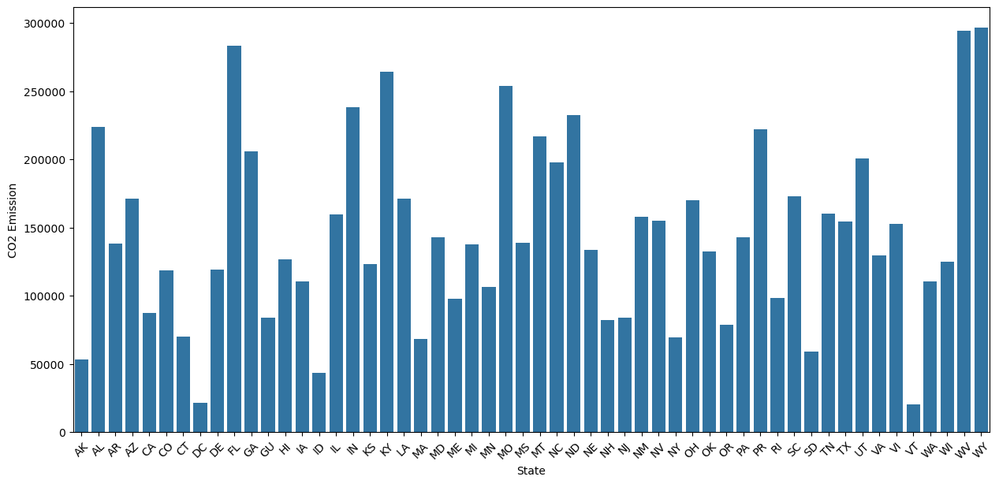

In [23]:
plt.figure(figsize=(15, 7))
sns.barplot(data=avg_co2, x="State", y="CO2 Emission")
plt.xticks(rotation=45, fontsize=10)


We can see soem states have realatively lower values then others and it looks to be states in the west witht he highest values. West virgina, wyoming and flordia appear to have the heightest.

In [ ]:
gas_types.isna().sum()
# checking how many na values 

Address Line 1         0
Address Line 2    203601
City                   0
CO2 Emission           0
County              5040
Facility ID            0
Gas Code               0
Gas Name               0
Latitude             226
Longitude            226
State                  0
State Name             0
Year                   0
Zip Code               0
Facility Name          0
FIPS                5059
dtype: int64

The number of umique values in eahc, could be useful to kno what to group by such as state, gas code and name 

In [ ]:
gas_types.nunique()

Address Line 1      8464
Address Line 2         0
City                4567
CO2 Emission      112528
County              2864
Facility ID         9083
Gas Code              12
Gas Name              12
Latitude            9653
Longitude           9657
State                 54
State Name            54
Year                  10
Zip Code            5378
Facility Name       9347
FIPS                2021
dtype: int64

In [ ]:
air_quality = pd.read_csv('us_air_quality_measures.csv')
air_quality.tail()

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
218630,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,Wyoming,56045,Weston,2007,6.207126,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
218631,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,Wyoming,56045,Weston,2008,6.369764,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
218632,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,Wyoming,56045,Weston,2009,6.241708,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
218633,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,Wyoming,56045,Weston,2010,6.125957,µg/m³,Micograms per cubic meter,Monitor & Modeled,0
218634,296,Annual average ambient concentrations of PM 2....,Average,State x County,56,Wyoming,56045,Weston,2011,6.646464,µg/m³,Micograms per cubic meter,Monitor & Modeled,0


The air_quality dataframe contains air quality measures across different states/counties in the United States. It contains over 218,000 entries.

In [ ]:
#  Next step is to change all addresses to uppercase or lowercase so we can merge

merged_gas_types_and_facilities = gas_types.merge(facilities, on = 'Address Line 1')
merged_gas_types_and_facilities.head(5)

,Address Line 1,Address Line 2_x,City_x,CO2 Emission,County_x,Facility ID,Gas Code,Gas Name,Latitude_x,Longitude_x,...,State Name_y,Year_y,Zip Code_y,Facility Name_y,Secondary NAICS Code,Additional NAICS Codes,Cogeneration Unit Emission Index(?),EPA Verified,Parent Company,Plant Code Indicator
0,1919 S. BROADWAY,NaN,GREEN BAY,58024.0,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.4925,-88.0323,...,WISCONSIN,2011.0,54304.0,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,322291.0,NaN,Y,NaN,KOCH INDUSTRIES INC (100%),NaN
1,1919 S. BROADWAY,NaN,GREEN BAY,58024.0,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.4925,-88.0323,...,WISCONSIN,2010.0,54304.0,GEORGIA-PACIFIC CONSUMER PRODUCTS LP,322291.0,NaN,Y,NaN,KOCH INDUSTRIES INC. (100%),NaN
2,1919 S. BROADWAY,NaN,GREEN BAY,58024.0,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.4925,-88.0323,...,WISCONSIN,2015.0,54304.0,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,322291.0,NaN,Y,NaN,KOCH INDUSTRIES INC (100%),Y
3,1919 S. BROADWAY,NaN,GREEN BAY,58024.0,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.4925,-88.0323,...,WISCONSIN,2018.0,54304.0,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,322291.0,NaN,N,NaN,KOCH INDUSTRIES INC (100%),Y
4,1919 S. BROADWAY,NaN,GREEN BAY,58024.0,BROWN COUNTY,1000589,BIOCO2,Biogenic CO2,44.4925,-88.0323,...,WISCONSIN,2013.0,54304.0,GEORGIA-PACIFIC CONSUMER OPERATIONS LLC,322291.0,NaN,Y,Y,KOCH INDUSTRIES INC (100%),Y


In [ ]:
merged_gas_types_and_facilities.value_counts("County_x")

County_x
HARRIS COUNTY      134593
DALLAS COUNTY       36679
Oklahoma            30413
OKLAHOMA COUNTY     29604
DENVER COUNTY       26115
                    ...  
METCALFE COUNTY         3
MEDINA COUNTY           3
LANDER COUNTY           2
LESLIE COUNTY           1
LEWIS AND CLARK         1
Name: count, Length: 2864, dtype: int64

In [ ]:
facilities.head(5)

,Address Line 1,Address Line 2,CEMS Used,City,County,FIPS,Facilities ID,Latitude,Longitude,NAICS Code,...,State Name,Year,Zip Code,Facility Name,Secondary NAICS Code,Additional NAICS Codes,Cogeneration Unit Emission Index(?),EPA Verified,Parent Company,Plant Code Indicator
0,301 COMMERCE DR. SUITE 3701,NaN,NaN,Fort Worth,NaN,NaN,1008536.0,35.533760,-97.529760,211111.0,...,TEXAS,2012.0,76102.0,TEP Barnett USA LLC 415 - Strawn Basin,NaN,NaN,N,NaN,CHESAPEAKE ENERGY CORP (100%),NaN
1,449 SHELL E&P COURT,NaN,NaN,Gibson,TERREBONNE,22109.0,1005071.0,29.628790,-90.917680,211112.0,...,LOUISIANA,2011.0,70358.0,North Terrebonne Gas Plant,NaN,NaN,N,NaN,ENTERPRISE GAS PROCESSING LLC (64.19%); DCP M...,NaN
2,5494 MALONE ROAD,NaN,NaN,MEMPHIS,SHELBY COUNTY,47157.0,1002466.0,34.999213,-89.906724,562212.0,...,TENNESSEE,2017.0,38116.0,SOUTH SHELBY LANDFILL,NaN,NaN,N,NaN,REPUBLIC SERVICES INC (100%),N
3,1601 WEEDON ISLAND DRIVE,NaN,NaN,SAINT PETERSBURG,Pinellas,12103.0,1001489.0,27.861300,-82.601200,221112.0,...,FLORIDA,2015.0,33702.0,P L Bartow Power Plant,NaN,NaN,N,NaN,DUKE ENERGY CORP (100%),Y
5,2237 HATCHER HILL RD,NaN,NaN,BACONTON,Mitchell,13205.0,1001409.0,31.386900,-84.081900,221112.0,...,GEORGIA,2011.0,31716.0,Baconton,NaN,NaN,N,NaN,SOWEGA ENERGY RESOURCES LLC. (65%); TEJAS POW...,NaN


In [ ]:
facilities.value_counts("County")

County
HARRIS COUNTY        1877
JEFFERSON COUNTY      858
DALLAS COUNTY         556
WASHINGTON COUNTY     535
MONTGOMERY COUNTY     484
                     ... 
COCKE                   1
GARRARD COUNTY          1
LAUDERDALE              1
LESLIE COUNTY           1
GEAUGA COUNTY           1
Name: count, Length: 2866, dtype: int64

^^ exploring to see what counties with the most data has the most data in our facilites, in case we wanted to look per county

In [ ]:
facilities['Latitude'].value_counts()

Latitude
29.758940    159
29.756080    120
29.752554    111
29.758160    102
35.533760     93
            ... 
42.283109      1
44.481161      1
42.309227      1
37.917778      1
36.040016      1
Name: count, Length: 9658, dtype: int64

In [ ]:
facilities.head()

,Address Line 1,Address Line 2,CEMS Used,City,County,FIPS,Facilities ID,Latitude,Longitude,NAICS Code,...,State Name,Year,Zip Code,Facility Name,Secondary NAICS Code,Additional NAICS Codes,Cogeneration Unit Emission Index(?),EPA Verified,Parent Company,Plant Code Indicator
0,301 COMMERCE DR. SUITE 3701,NaN,NaN,Fort Worth,NaN,NaN,1008536.0,35.533760,-97.529760,211111.0,...,TEXAS,2012.0,76102.0,TEP Barnett USA LLC 415 - Strawn Basin,NaN,NaN,N,NaN,CHESAPEAKE ENERGY CORP (100%),NaN
1,449 SHELL E&P COURT,NaN,NaN,Gibson,TERREBONNE,22109.0,1005071.0,29.628790,-90.917680,211112.0,...,LOUISIANA,2011.0,70358.0,North Terrebonne Gas Plant,NaN,NaN,N,NaN,ENTERPRISE GAS PROCESSING LLC (64.19%); DCP M...,NaN
2,5494 MALONE ROAD,NaN,NaN,MEMPHIS,SHELBY COUNTY,47157.0,1002466.0,34.999213,-89.906724,562212.0,...,TENNESSEE,2017.0,38116.0,SOUTH SHELBY LANDFILL,NaN,NaN,N,NaN,REPUBLIC SERVICES INC (100%),N
3,1601 WEEDON ISLAND DRIVE,NaN,NaN,SAINT PETERSBURG,Pinellas,12103.0,1001489.0,27.861300,-82.601200,221112.0,...,FLORIDA,2015.0,33702.0,P L Bartow Power Plant,NaN,NaN,N,NaN,DUKE ENERGY CORP (100%),Y
5,2237 HATCHER HILL RD,NaN,NaN,BACONTON,Mitchell,13205.0,1001409.0,31.386900,-84.081900,221112.0,...,GEORGIA,2011.0,31716.0,Baconton,NaN,NaN,N,NaN,SOWEGA ENERGY RESOURCES LLC. (65%); TEJAS POW...,NaN


Lets see if there is a pattern in the distribution of our facilites by lattitude and logittude 

First attempt not the best, cant tell much from this graph, hmm lets think of another way.

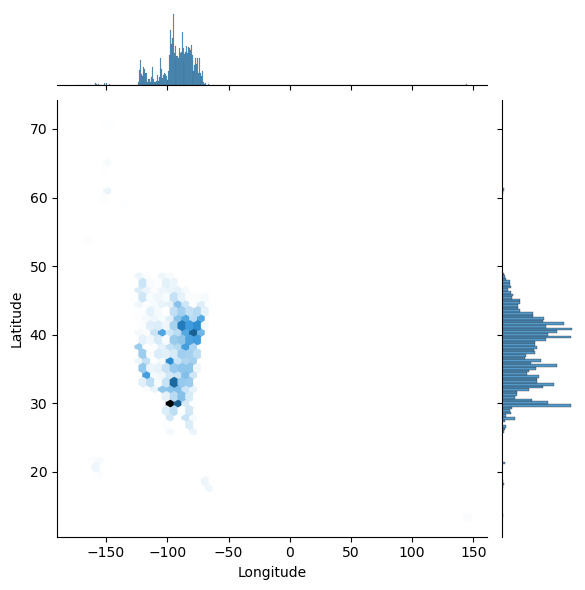

In [ ]:
graph=facilities[['Latitude','Longitude']].dropna()
sns.jointplot(data=graph, x='Longitude', y='Latitude', kind="hex")

This is data for plotting countries from the natural earth. You can acess the files needed to download at https://www.naturalearthdata.com/downloads/110m-cultural-vectors/110m-admin-0-countries/ and you will need geopandas to work with the data. The data come sin many forms (.endings) will use the .shp one for the plotting but it will need to ahve all the other downloaded files in the same path as the .shp one for rendering 

In [ ]:
world = gpd.read_file('ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp')
world.head()

,featurecla,scalerank,LABELRANK,SOVEREIGNT,SOV_A3,ADM0_DIF,LEVEL,TYPE,TLC,ADMIN,...,FCLASS_TR,FCLASS_ID,FCLASS_PL,FCLASS_GR,FCLASS_IT,FCLASS_NL,FCLASS_SE,FCLASS_BD,FCLASS_UA,geometry
0,Admin-0 country,1,6,Fiji,FJI,0,2,Sovereign country,1,Fiji,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((180.00000 -16.06713, 180.00000..."
1,Admin-0 country,1,3,United Republic of Tanzania,TZA,0,2,Sovereign country,1,United Republic of Tanzania,...,None,None,None,None,None,None,None,None,None,"POLYGON ((33.90371 -0.95000, 34.07262 -1.05982..."
2,Admin-0 country,1,7,Western Sahara,SAH,0,2,Indeterminate,1,Western Sahara,...,Unrecognized,Unrecognized,Unrecognized,None,None,Unrecognized,None,None,None,"POLYGON ((-8.66559 27.65643, -8.66512 27.58948..."
3,Admin-0 country,1,2,Canada,CAN,0,2,Sovereign country,1,Canada,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84000 49.00000, -122.9742..."
4,Admin-0 country,1,2,United States of America,US1,1,2,Country,1,United States of America,...,None,None,None,None,None,None,None,None,None,"MULTIPOLYGON (((-122.84000 49.00000, -120.0000..."


Goal: plot the distribution of facilities as a density plot over the united states, and maybe then comapre this to our bar graphs to see if there is higher air quality in less dense areas.

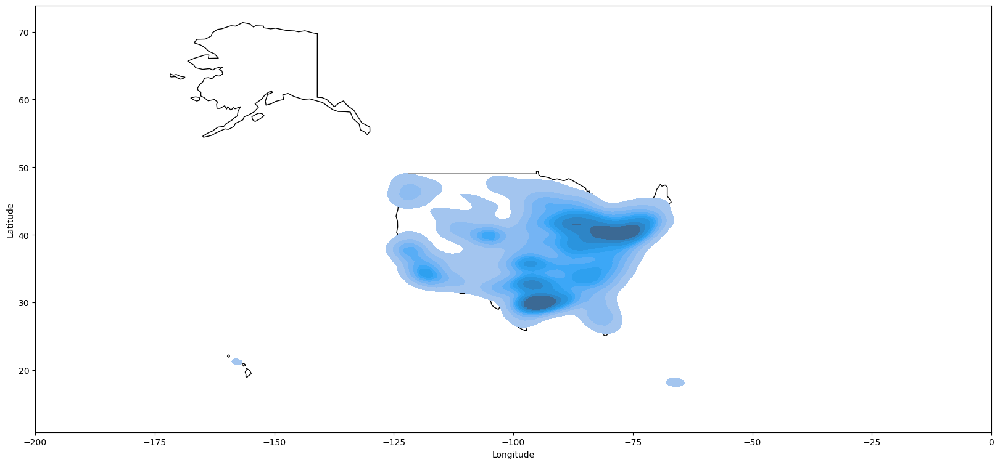

In [ ]:
import geopandas as gpd
import seaborn as sns
import matplotlib.pyplot as plt
world = gpd.read_file('ne_110m_admin_0_countries/ne_110m_admin_0_countries.shp')

# Filter for the United States
us = world[world['ADMIN'] == "United States of America"]

# Create a base matplotlib axis
fig, ax = plt.subplots(figsize=(20, 20))
ax.set_xlim([-200, 0])
ax.set_aspect('equal')

# Plot the United States on that axis
us.plot(ax=ax, color="white", edgecolor="black")

# Overlay the KDE plot on the same axis
sns.kdeplot(data=graph, x='Longitude', y='Latitude', fill=True, ax=ax)

plt.show()

At first glace it does apear that our data for air quality aligns slight with the density data but not exactly. We see larger density in the northern/east and south part of the country.

In [ ]:
sns.kdeplot(data=graph, x='Longitude', y='Latitude', fill=True, ax=ax)

<Axes: xlabel='Longitude', ylabel='Latitude'>

### Feature Engineering into new Dataframe
In this section we plan to condense the data we have now down into one data frame with the most important features so we can begin to make our model. We will use soem information from our previous exploring and consider adding new features 

From previos exploration we know our air quality data doesnt correspond directly with our facility emssion data so lets check if there are certain years that would be the best.

In [15]:
gas_types['Year'].value_counts()

Year
2014    21381
2015    21078
2013    21017
2012    20804
2018    20751
2016    20741
2019    20613
2017    20457
2011    20226
2010    16533
Name: count, dtype: int64

In [16]:
air_quality['ReportYear'].value_counts()

ReportYear
2003    18891
2002    18890
2004    18854
2005    18817
2001    18812
2009    18744
2008    18735
2010    18720
2006    18713
2007    18709
2011    18681
2000     3194
2012     3077
2013     3066
1999     2732
Name: count, dtype: int64

Decide to use only data from the year 2011, as out of the years we have both emission and air quality data for, it has far more values then our other options.

In [53]:
# create new data frames containing only data from 2011
gas_types_2011 = gas_types[gas_types["Year"]==2011]
air_quality_2011 = air_quality[air_quality["ReportYear"]==2011]

In [54]:
# save as cvs files 
air_quality_2011.to_csv("air_quality_2011.csv")

Our emsison facilies currenly contains one column called "CO2 Emisison" which is a miss leading title as it actually contains the emission values for a coresponding column called gas code, which gives the real gas type the values in CO2 Emssions correspond too. Lets seperate these into their own columns.

In [22]:
pivot_df = gas_types_2011.pivot_table(
    index='County',      # Rows (index) will be 'county'
    columns='Gas Code',  # Columns will be the unique values from 'gas_type'
    values='CO2 Emission',  # Values in the cells will be the 'emissions'
    aggfunc='sum'        # Aggregate function to combine emissions, sum in this case
)

In [23]:
pivot_df.head()
# will replace NaN with 0s later

Gas Code,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT
County,,,,,,,,,,,,
ACADIA,NaN,64528.9750,1.507179e+06,NaN,NaN,833.804,NaN,NaN,NaN,NaN,NaN,NaN
ACCOMACK,NaN,159248.0000,9.140520e+04,NaN,NaN,214.560,NaN,NaN,NaN,NaN,NaN,NaN
ADA,NaN,28879.7500,3.627700e+04,750.498,162.8066,20.860,7275.6,NaN,17558.0,5664.743,44724.48,NaN
ADAMS,NaN,316171.2284,2.633173e+07,NaN,NaN,119963.476,NaN,NaN,NaN,NaN,85397.40,NaN
ADDISON,NaN,NaN,2.593690e+04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Want to predict our airquality from gas emissions however using gas emssion alone we dont think will be a good enoughb predicotor of air quality. There are other factors contributing to air quality other than emissionsion facolities such as distance to coast, as places closer to the coast tend to have lower air quality. Since we have lattitude and logitiude data for our facilities lets caluclate their distance from the coast. This uses data set of lattitde and logitude values of the coast line from natrual earth data. And the geo pandas libaray for working with our lattitude and logiitude values. (https://www.naturalearthdata.com/downloads/10m-physical-vectors/10m-coastline/)

In [24]:
import geopandas as gpd

coastline = gpd.read_file('ne_10m_coastline/ne_10m_coastline.shp')

In [25]:
# checking to see what type of meassurments our lattitude and logitude data is in 
# currently in EPSG:4326 which is angles 
coastline.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

In [29]:

# converts our gas type to a geo pandas data frame for calcualtions
gdf= gpd.GeoDataFrame(gas_types_2011, geometry=gpd.points_from_xy(gas_types_2011.Longitude, gas_types_2011.Latitude))


# Ensure both dataframes use the same CRS
# convert latittude and longitude data to Conus Albers meassuments 
# this is a way to represent lattitude and longitutde in terms of meters
# for distance calcualtion

gdf = gdf.set_crs(coastline.crs)
gdf= gdf.to_crs("EPSG:5070")

coastline= coastline.to_crs("EPSG:5070")



In [55]:
from shapely.ops import nearest_points

# shapely pacckage allows manituplation of geogmetric objects
# nearest point will find the nearest lattitude and logitude values
# to current one from any one in other data set 

def distance_to_coast(point, coastlines):
    nearest_coast = nearest_points(point, coastlines.unary_union)[1]
    return point.distance(nearest_coast)


In [ ]:
g## !!! Takes a really long time to run !!!
# the coastline data fram ehas values from all the coastline in whole world so
# the iterations through it takes a while 

gdf['distance_to_coast'] = gdf.geometry.apply(lambda x: distance_to_coast(x, coastline))

In [ ]:
gdf.head()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,Year,Zip Code,Facility Name,geometry,distance_to_coast
10,27155 SOUTH KANKAKEE Street,MANHATTAN,12.516,WILL,1001369,N2O,NITROUS OXIDE,41.393700,-87.943700,ILLINOIS,2011,60442,LINCOLN GENERATING FACILITY,POINT (667712.576 2071386.664),9.557503e+05
16,449 Shell E&P Court,GIBSON,382855.300,TERREBONNE,1005071,CO2,CARBON DIOXIDE,29.628790,-90.917680,LOUISIANA,2011,70358,NORTH TERREBONNE GAS PLANT,POINT (491815.612 741352.484),2.935047e+04
19,13675 WELD COUNTY ROAD 34,PLATTEVILLE,29.204,WELD,1005678,N2O,NITROUS OXIDE,40.232045,-104.798221,COLORADO,2011,80651,PLATTEVILLE GAS PLANT,POINT (-741061.988 1947304.348),1.252961e+06
35,1801 California Street Suite 2500,DENVER,191015.750,DENVER,1009714,CH4,METHANE,39.747704,-104.989786,COLORADO,2011,80202,FEPC 220 GULF COAST BASIN,POINT (-762275.599 1894788.124),1.201004e+06
44,3301 BOWMAN ROAD,RIDGECREST,3621.250,KERN,1002897,CH4,METHANE,35.602900,-117.738800,CALIFORNIA,2011,93555,RIDGECREST-INYOKERN SANITARY LANDFILL,POINT (-1935318.091 1616597.779),1.895937e+05


In [ ]:
# saved as csv file to prevent having to run again 
gdf.to_csv('distance_from_coast.csv', index= False )

Hypothesizing that the distance the facility is to a major city might also effect air quality as larger cities have more population and more air pollution. Perform a simular method that we did with the coastline data frame but now using a data base of cities with lattitude and lognitude with their populations from the simplemaps (https://simplemaps.com/data/us-cities)

In [56]:
cities=pd.read_excel("uscities.xlsx", sheet_name='Sheet1', engine='openpyxl')
cities.head()

,city,city_ascii,state_id,state_name,county_fips,county_name,lat,lng,population,density,source,military,incorporated,timezone,ranking,zips,id
0,New York,New York,NY,New York,36081,Queens,40.6943,-73.9249,18908608,11226.2,shape,False,True,America/New_York,1,11229 11228 11226 11225 11224 11222 11221 1122...,1840034016
1,Los Angeles,Los Angeles,CA,California,6037,Los Angeles,34.1141,-118.4068,11922389,3202.3,shape,False,True,America/Los_Angeles,1,91367 90291 90293 90292 91316 91311 90035 9003...,1840020491
2,Chicago,Chicago,IL,Illinois,17031,Cook,41.8375,-87.6866,8497759,4648.7,shape,False,True,America/Chicago,1,60018 60649 60641 60640 60643 60642 60645 6064...,1840000494
3,Miami,Miami,FL,Florida,12086,Miami-Dade,25.7840,-80.2101,6080145,4728.2,shape,False,True,America/New_York,1,33128 33129 33125 33126 33127 33149 33144 3314...,1840015149
4,Houston,Houston,TX,Texas,48201,Harris,29.7860,-95.3885,5970127,1382.2,shape,False,True,America/Chicago,1,77069 77068 77061 77060 77063 77062 77065 7706...,1840020925


Choose cities with a population over 1000000 to represent as major city

In [58]:
cities['population'] = cities['population'].astype(int)
major_cities= cities[cities['population']>= 1000000]
major_cities.size

833

In [59]:
# use same process as before wasnt our latttitude and longitude to be interms
# of meters so we can do distance calcualtions 

# gdf2 represent geo data frame of gas types from 2011

gdf2= gpd.GeoDataFrame(gas_types_2011, geometry=gpd.points_from_xy(gas_types_2011.Longitude, gas_types_2011.Latitude))
gdf2 = gdf2.set_crs("EPSG:4326")
gdf2= gdf2.to_crs("EPSG:5070")

gcities = gpd.GeoDataFrame(major_cities, geometry=gpd.points_from_xy(major_cities.lng, major_cities.lat))
gcities=gcities.set_crs("EPSG:4326")
gcities=gcities.to_crs("EPSG:5070")


In [60]:
def distance_to_nearest_major_city(point, major_cities):
    # Find the nearest major city to the given point
    nearest_city = nearest_points(point, major_cities.unary_union)[1]
    # Calculate the distance to the nearest major city
    return point.distance(nearest_city)


In [61]:
gcities['city']= gcities['city'].str.upper()


In [62]:
# add an additonal column on wehther the city was already listed 
# as a city containing 1000000+ people as the distances are calucated 
# from on set point and cities cover a radius 
# thought it might effects data
gdf2['is_major_city'] = gdf2['City'].apply(lambda x: 'yes' if x in gcities['city'].values else 'no')

In [63]:
# adding our distance to nearest city column 
gdf2['distance_to_nearest_major_city'] = gdf2.geometry.apply(lambda x: distance_to_nearest_major_city(x, gcities))

In [64]:
gdf2.head()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,Year,Zip Code,Facility Name,geometry,is_major_city,distance_to_nearest_major_city
10,27155 SOUTH KANKAKEE Street,MANHATTAN,12.516,WILL,1001369,N2O,NITROUS OXIDE,41.393700,-87.943700,ILLINOIS,2011,60442,LINCOLN GENERATING FACILITY,POINT (667712.576 2071386.664),yes,54027.245635
16,449 Shell E&P Court,GIBSON,382855.300,TERREBONNE,1005071,CO2,CARBON DIOXIDE,29.628790,-90.917680,LOUISIANA,2011,70358,NORTH TERREBONNE GAS PLANT,POINT (491815.612 741352.484),no,432748.278305
19,13675 WELD COUNTY ROAD 34,PLATTEVILLE,29.204,WELD,1005678,N2O,NITROUS OXIDE,40.232045,-104.798221,COLORADO,2011,80651,PLATTEVILLE GAS PLANT,POINT (-741061.988 1947304.348),no,53074.458497
35,1801 California Street Suite 2500,DENVER,191015.750,DENVER,1009714,CH4,METHANE,39.747704,-104.989786,COLORADO,2011,80202,FEPC 220 GULF COAST BASIN,POINT (-762275.599 1894788.124),yes,9810.448711
44,3301 BOWMAN ROAD,RIDGECREST,3621.250,KERN,1002897,CH4,METHANE,35.602900,-117.738800,CALIFORNIA,2011,93555,RIDGECREST-INYOKERN SANITARY LANDFILL,POINT (-1935318.091 1616597.779),no,177220.309367


In [ ]:
# set the distance to zero if already a major city
# might want to skip this step if recreating as I inadvetrntly combined
# the future one hot encoding i wanted to do with the is major city column
gdf2.loc[gdf2['is_major_city'] == 'yes', 'distance_to_nearest_major_city'] = 0

In [ ]:
gdf2.head()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,Year,Zip Code,Facility Name,geometry,is_major_city,distance_to_nearest_major_city
10,27155 SOUTH KANKAKEE Street,MANHATTAN,12.516,WILL,1001369,N2O,NITROUS OXIDE,41.393700,-87.943700,ILLINOIS,2011,60442,LINCOLN GENERATING FACILITY,POINT (667712.576 2071386.664),yes,0.000000
16,449 Shell E&P Court,GIBSON,382855.300,TERREBONNE,1005071,CO2,CARBON DIOXIDE,29.628790,-90.917680,LOUISIANA,2011,70358,NORTH TERREBONNE GAS PLANT,POINT (491815.612 741352.484),no,432748.278305
19,13675 WELD COUNTY ROAD 34,PLATTEVILLE,29.204,WELD,1005678,N2O,NITROUS OXIDE,40.232045,-104.798221,COLORADO,2011,80651,PLATTEVILLE GAS PLANT,POINT (-741061.988 1947304.348),no,53074.458497
35,1801 California Street Suite 2500,DENVER,191015.750,DENVER,1009714,CH4,METHANE,39.747704,-104.989786,COLORADO,2011,80202,FEPC 220 GULF COAST BASIN,POINT (-762275.599 1894788.124),yes,0.000000
44,3301 BOWMAN ROAD,RIDGECREST,3621.250,KERN,1002897,CH4,METHANE,35.602900,-117.738800,CALIFORNIA,2011,93555,RIDGECREST-INYOKERN SANITARY LANDFILL,POINT (-1935318.091 1616597.779),no,177220.309367


In [ ]:
# save as seperate csv file
# contains the gas emisison values from 2011 and our new city data
gdf2.to_csv('is_major_city.csv', index = False)

In [ ]:
# gdf is the data frame containg gas emssions from 2011 and distance to coast values
# gdf2 is data frame containing our new city values, and emisison form 2011
# merge them together 

combined_gdf = gdf.merge(gdf2, left_index=True, right_index=True, how='outer', suffixes=('', '_y'))
combined_gdf = combined_gdf.drop([col for col in combined_gdf if col.endswith('_y')], axis=1)

In [ ]:
combined_gdf.head()

,Address Line 1,City,CO2 Emission,County,Facility ID,Gas Code,Gas Name,Latitude,Longitude,State Name,Year,Zip Code,Facility Name,geometry,distance_to_coast,is_major_city,distance_to_nearest_major_city
10,27155 SOUTH KANKAKEE Street,MANHATTAN,12.516,WILL,1001369,N2O,NITROUS OXIDE,41.393700,-87.943700,ILLINOIS,2011,60442,LINCOLN GENERATING FACILITY,POINT (667712.576 2071386.664),9.557503e+05,yes,0.000000
16,449 Shell E&P Court,GIBSON,382855.300,TERREBONNE,1005071,CO2,CARBON DIOXIDE,29.628790,-90.917680,LOUISIANA,2011,70358,NORTH TERREBONNE GAS PLANT,POINT (491815.612 741352.484),2.935047e+04,no,432748.278305
19,13675 WELD COUNTY ROAD 34,PLATTEVILLE,29.204,WELD,1005678,N2O,NITROUS OXIDE,40.232045,-104.798221,COLORADO,2011,80651,PLATTEVILLE GAS PLANT,POINT (-741061.988 1947304.348),1.252961e+06,no,53074.458497
35,1801 California Street Suite 2500,DENVER,191015.750,DENVER,1009714,CH4,METHANE,39.747704,-104.989786,COLORADO,2011,80202,FEPC 220 GULF COAST BASIN,POINT (-762275.599 1894788.124),1.201004e+06,yes,0.000000
44,3301 BOWMAN ROAD,RIDGECREST,3621.250,KERN,1002897,CH4,METHANE,35.602900,-117.738800,CALIFORNIA,2011,93555,RIDGECREST-INYOKERN SANITARY LANDFILL,POINT (-1935318.091 1616597.779),1.895937e+05,no,177220.309367


In [ ]:
# perform the fucntion to seperate gass emsision by gas code as talked about earlier
# but with the combined data frame

pivot_df2 = combined_gdf.pivot_table(
    index=['Address Line 1', 'City','County','State Name', 'is_major_city', 'distance_to_nearest_major_city', 'distance_to_coast', 'Facility ID'], # Rows (index) will include these three columns
    columns='Gas Code',  # Columns will be the unique values from 'Gas Code'
    values='CO2 Emission',  # Values in the cells will be 'CO2 Emission'
    aggfunc='sum'        # Aggregate function to combine 'CO2 Emission', sum in this case
)

In [ ]:
pivot_df2

,,,,,,,Gas Code,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT
Address Line 1,City,County,State Name,is_major_city,distance_to_nearest_major_city,distance_to_coast,Facility ID,,,,,,,,,,,,
5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,38999.4,NaN
#1 CHESSEN LANE,ALTON,MADISON,ILLINOIS,no,27332.531409,928112.883957,1001527,NaN,9671.25,3347341.1,NaN,NaN,16768.162,NaN,NaN,NaN,NaN,NaN,NaN
#1 Estate Annaberg and Shannon Grove,KINGSHILL,ST.,VIRGIN ISLANDS,no,159053.514600,1268.965385,1010700,NaN,3332.50,28479.7,NaN,NaN,68.838,NaN,NaN,NaN,NaN,NaN,NaN
#1 Georgia-Pacific Drive,FORDYCE,DALLAS,ARKANSAS,no,265526.749825,426803.295122,1010844,109490.0,944.50,22961.0,NaN,NaN,1473.908,NaN,NaN,NaN,NaN,NaN,NaN
#1 INDUSTRIAL HWY,EDDYSTONE,DELAWARE,PENNSYLVANIA,no,23192.910330,398.779076,1000898,NaN,1194.75,558822.3,NaN,NaN,2056.796,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
WEST ROUNDBUNCH ROAD,BRIDGE CITY,ORANGE,TEXAS,no,148413.219858,4638.548900,1006721,NaN,1364.75,2941761.5,NaN,NaN,1626.782,NaN,NaN,NaN,NaN,NaN,NaN
WOOD AVE SOUTH,LINDEN,UNION,NEW JERSEY,no,22033.182560,125.329566,1007330,NaN,982.50,2113200.3,NaN,NaN,1177.696,NaN,NaN,NaN,NaN,NaN,NaN
WV STATE ROUTE 2,CAPTINA,MARSHALL,WEST VIRGINIA,no,98450.858157,333577.109298,1000976,NaN,23991.25,8303396.8,NaN,NaN,41599.310,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
# fill the Nan values with 0s as a makeshift one hot encode
model_df = pivot_df2.reset_index()
model_df = model_df.fillna(0)

In [ ]:
model_df.head()

Gas Code,Address Line 1,City,County,State Name,is_major_city,distance_to_nearest_major_city,distance_to_coast,Facility ID,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT
0,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.00,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,38999.4,0.0
1,#1 CHESSEN LANE,ALTON,MADISON,ILLINOIS,no,27332.531409,928112.883957,1001527,0.0,9671.25,3347341.1,0.0,0.0,16768.162,0.0,0.0,0.0,0.0,0.0,0.0
2,#1 Estate Annaberg and Shannon Grove,KINGSHILL,ST.,VIRGIN ISLANDS,no,159053.514600,1268.965385,1010700,0.0,3332.50,28479.7,0.0,0.0,68.838,0.0,0.0,0.0,0.0,0.0,0.0
3,#1 Georgia-Pacific Drive,FORDYCE,DALLAS,ARKANSAS,no,265526.749825,426803.295122,1010844,109490.0,944.50,22961.0,0.0,0.0,1473.908,0.0,0.0,0.0,0.0,0.0,0.0
4,#1 INDUSTRIAL HWY,EDDYSTONE,DELAWARE,PENNSYLVANIA,no,23192.910330,398.779076,1000898,0.0,1194.75,558822.3,0.0,0.0,2056.796,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# save to csv file then read back in
model_df.to_csv('modeling1.csv', index = False)
df= pd.read_csv('modeling1.csv')

In [ ]:
df.head()

,Address Line 1,City,County,State Name,is_major_city,distance_to_nearest_major_city,distance_to_coast,Facility ID,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT
0,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.00,0.0,0.0,0.0,0.000,0.0,0.0,0.0,0.0,38999.4,0.0
1,#1 CHESSEN LANE,ALTON,MADISON,ILLINOIS,no,27332.531409,928112.883957,1001527,0.0,9671.25,3347341.1,0.0,0.0,16768.162,0.0,0.0,0.0,0.0,0.0,0.0
2,#1 Estate Annaberg and Shannon Grove,KINGSHILL,ST.,VIRGIN ISLANDS,no,159053.514600,1268.965385,1010700,0.0,3332.50,28479.7,0.0,0.0,68.838,0.0,0.0,0.0,0.0,0.0,0.0
3,#1 Georgia-Pacific Drive,FORDYCE,DALLAS,ARKANSAS,no,265526.749825,426803.295122,1010844,109490.0,944.50,22961.0,0.0,0.0,1473.908,0.0,0.0,0.0,0.0,0.0,0.0
4,#1 INDUSTRIAL HWY,EDDYSTONE,DELAWARE,PENNSYLVANIA,no,23192.910330,398.779076,1000898,0.0,1194.75,558822.3,0.0,0.0,2056.796,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
air_quality_2011.head()

,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
357,86,Person-days with PM2.5 over the National Ambie...,Counts,State x County,39,OHIO,39057,GREENE,2011,0.0,No Units,No Units,Monitor Only,1
564,86,Person-days with PM2.5 over the National Ambie...,Counts,State x County,13,GEORGIA,13067,COBB,2011,0.0,No Units,No Units,Monitor Only,1
2400,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,21,KENTUCKY,21093,HARDIN,2011,0.0,%,Percent,Monitor Only,1
3580,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,39,OHIO,39057,GREENE,2011,0.0,%,Percent,Monitor Only,1
3776,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,13,GEORGIA,13067,COBB,2011,0.0,%,Percent,Monitor Only,1


In [4]:
# read in the air quality data from 2011 that we made 
air_quality_2011=pd.read_csv('air_quality_2011.csv')

In [44]:
air_quality_2011.head()

,Unnamed: 0,MeasureId,MeasureName,MeasureType,StratificationLevel,StateFips,StateName,CountyFips,CountyName,ReportYear,Value,Unit,UnitName,DataOrigin,MonitorOnly
0,357,86,Person-days with PM2.5 over the National Ambie...,Counts,State x County,39,OHIO,39057,GREENE,2011,0.0,No Units,No Units,Monitor Only,1
1,564,86,Person-days with PM2.5 over the National Ambie...,Counts,State x County,13,GEORGIA,13067,COBB,2011,0.0,No Units,No Units,Monitor Only,1
2,2400,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,21,KENTUCKY,21093,HARDIN,2011,0.0,%,Percent,Monitor Only,1
3,3580,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,39,OHIO,39057,GREENE,2011,0.0,%,Percent,Monitor Only,1
4,3776,85,Percent of days with PM2.5 levels over the Nat...,Percent,State x County,13,GEORGIA,13067,COBB,2011,0.0,%,Percent,Monitor Only,1


Want to sperate our messure types and make them seperate columns as from previous exploration we believe average will be the best meassure as it has the most points.

In [5]:
pivot_df3 = air_quality_2011.pivot_table(
    index=['CountyFips', 'CountyName','StateFips', 'StateName'], # Rows (index) will include these three columns
    columns='MeasureType',  
    values='Value',
    aggfunc= 'sum' 
) 

# sums up the averages, counts, percent, for each messure names 

In [97]:
pivot_df3

,,,MeasureType,Average,Counts,Percent
CountyFips,CountyName,StateFips,StateName,,,
1001,AUTAUGA,1,ALABAMA,11.106039,0.0,0.000000
1003,BALDWIN,1,ALABAMA,19.559671,746912.0,0.000000
1005,BARBOUR,1,ALABAMA,10.793651,0.0,0.000000
1007,BIBB,1,ALABAMA,11.035070,0.0,0.000000
1009,BLOUNT,1,ALABAMA,11.630947,57743.0,0.000000
...,...,...,...,...,...,...
56037,SWEETWATER,56,WYOMING,11.886618,230374.0,1.432901
56039,TETON,56,WYOMING,10.286342,21441.0,0.273973
56041,UINTA,56,WYOMING,7.112782,41866.0,0.547945


In [6]:
df_airquality = pivot_df3.reset_index()

In [7]:
df_model = pd.read_csv('modeling1.csv')

In [11]:
df_w_air_emision = pd.merge(df_model, df_airquality, left_on = 'County', right_on='CountyName', how = 'left')

In [15]:
df_w_air_emision=df_w_air_emision.drop(['CountyName', 'StateName'], axis = 1)

In [16]:
df_w_air_emision.head() # merged the data frame with our modeling dataframe 

,Address Line 1,City,County,State Name,is_major_city,distance_to_nearest_major_city,distance_to_coast,Facility ID,BIOCO2,CH4,...,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT,CountyFips,StateFips,Average,Counts,Percent
0,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.0,...,0.0,0.0,0.0,38999.4,0.0,5019.0,5.0,10.873042,0.0,0.0
1,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.0,...,0.0,0.0,0.0,38999.4,0.0,16033.0,16.0,5.864435,0.0,0.0
2,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.0,...,0.0,0.0,0.0,38999.4,0.0,17023.0,17.0,11.013250,0.0,0.0
3,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.0,...,0.0,0.0,0.0,38999.4,0.0,18019.0,18.0,25.739090,1450280.0,0.0
4,5411 NE Hwy 99,VANCOUVER,CLARK,WASHINGTON,no,13960.507058,68943.337049,1005611,0.0,0.0,...,0.0,0.0,0.0,38999.4,0.0,20025.0,20.0,7.619427,2130.0,0.0


This is our main data frame we will use for modeling !!!

In [17]:
df_w_air_emision.to_csv('airquality_w_emmission.csv', index = False)

In [21]:
df_grouped = df_w_air_emision.groupby('County').apply(lambda x: x.select_dtypes(include=['number']).mean()) 
# grouped by county for modleing data frame as we technically only have data per 
# county for the air quality
# might be useful for modeling 

In [23]:
df_grouped.reset_index()

,County,distance_to_nearest_major_city,distance_to_coast,Facility ID,BIOCO2,CH4,CO2,HFC,HFE,N2O,...,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT,CountyFips,StateFips,Average,Counts,Percent
0,ACADIA,285785.585203,62817.426007,1.005908e+06,0.0000,9218.425000,2.153113e+05,0.0000,0.00000,119.114857,...,0.0,0.0,0.00000,0.000,0.0,22001.000000,22.000000,9.432053,123596.00,0.000000
1,ACCOMACK,133618.125407,7760.670509,1.005067e+06,0.0000,53082.666667,3.046840e+04,0.0000,0.00000,71.520000,...,0.0,0.0,0.00000,0.000,0.0,51001.000000,51.000000,8.752211,200052.00,0.000000
2,ADA,473978.816460,618112.494567,1.004686e+06,0.0000,7219.937500,9.069250e+03,187.6245,40.70165,5.215000,...,0.0,4389.5,1416.18575,11181.120,0.0,16001.000000,16.000000,16.702943,401039.00,0.273973
3,ADAMS,188786.200675,895574.817392,1.002968e+06,0.0000,13173.801183,1.097156e+06,0.0000,0.00000,4998.478167,...,0.0,0.0,0.00000,3558.225,0.0,30334.666667,30.333333,10.455699,417596.75,0.091137
4,ADDISON,254979.657351,150458.594873,1.011305e+06,0.0000,0.000000,2.593690e+04,0.0000,0.00000,0.000000,...,0.0,0.0,0.00000,0.000,0.0,50001.000000,50.000000,8.314185,0.00,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1169,YOAKUM,558875.469175,751266.227143,1.003700e+06,0.0000,9002.400000,3.058279e+05,0.0000,0.00000,182.376000,...,0.0,0.0,0.00000,0.000,0.0,48501.000000,48.000000,7.799913,0.00,0.000000
1170,YOLO,20118.185002,50257.650828,1.006065e+06,78.2750,9423.875000,2.536272e+04,0.0000,0.00000,6037.852500,...,0.0,0.0,0.00000,0.000,0.0,6113.000000,6.000000,17.361437,3473037.00,4.160669
1171,YORK,102698.721456,216765.610333,1.003712e+06,148111.5125,13438.890625,7.597114e+05,0.0000,0.00000,5846.052250,...,0.0,0.0,0.00000,0.000,0.0,38527.800000,38.400000,12.359189,1098232.00,0.000000
1172,YUBA,61501.010585,109736.637604,1.004852e+06,0.0000,91538.625000,0.000000e+00,0.0000,0.00000,0.000000,...,0.0,0.0,0.00000,0.000,0.0,6115.000000,6.000000,8.900070,580532.00,1.095890


This is version grouped by county, as we technically only hve county data for our airquality so might be useful

In [24]:
df_grouped.to_csv('airquality_w_emmision_bycounty.csv', index = False)

In [1]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model as lm

First attempt at modleing however this one does not work well so feel free to skipp to the section with bold heading "Modeling" 

In [4]:
df= pd.read_csv("csv_data/airquality_w_emmission.csv")

In [6]:
df_modeling= df.drop(["Address Line 1","State Name","City", "County", "County", "Facility ID","CountyFips", "StateFips"  ], axis=1)

In [7]:
df_modeling.head()

,is_major_city,distance_to_nearest_major_city,distance_to_coast,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT,Average,Counts,Percent
0,no,13960.507058,68943.337049,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,10.873042,0.0,0.0
1,no,13960.507058,68943.337049,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,5.864435,0.0,0.0
2,no,13960.507058,68943.337049,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,11.013250,0.0,0.0
3,no,13960.507058,68943.337049,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,25.739090,1450280.0,0.0
4,no,13960.507058,68943.337049,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,7.619427,2130.0,0.0


In [10]:
df_modeling['is_major_city'] = df['is_major_city'].map({'yes': 1, 'no': 0})
df_modeling['distance_to_nearest_major_city']=df_modeling['distance_to_nearest_major_city']/1000
df_modeling['distance_to_coast'] = df_modeling['distance_to_coast']/1000 

In [11]:
df_modeling.head()

,is_major_city,distance_to_nearest_major_city,distance_to_coast,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT,Average,Counts,Percent
0,0,13.960507,68.943337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,10.873042,0.0,0.0
1,0,13.960507,68.943337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,5.864435,0.0,0.0
2,0,13.960507,68.943337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,11.013250,0.0,0.0
3,0,13.960507,68.943337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,25.739090,1450280.0,0.0
4,0,13.960507,68.943337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,38999.4,0.0,7.619427,2130.0,0.0


In [10]:
def train_val_split(data):
    """ 
    Takes in a DataFrame `data` and randomly splits it into two smaller DataFrames 
    named `train` and `validation` with 80% and 20% of the data, respectively. 
    """
    
    data_len = data.shape[0]
    shuffled_indices = np.random.permutation(data_len)
    data_shuffled= data.iloc[shuffled_indices]
    train = data_shuffled.iloc[:int(data_shuffled.shape[0]*0.8)]
    validation = data_shuffled.iloc[int(data_shuffled.shape[0]*0.8):]
   
    return train, validation

train, test = train_val_split(df_modeling)

Plot our features as a scatter to see correlation however was not the best method as you will see due to the categoricalness / one hotencoding

In [8]:
import pandas as pd
import matplotlib.pyplot as plt

def plot_scatter(df, column1, column2):
    """
    Plots a scatter plot of two columns in a pandas DataFrame.

    Args:
    df (pandas.DataFrame): The DataFrame containing the data.
    column1 (str): The name of the first column to plot.
    column2 (str): The name of the second column to plot.

    Returns:
    None: The function plots the scatter plot but does not return anything.
    """
    if column1 not in df.columns or column2 not in df.columns:
        raise ValueError("One or both columns not found in the DataFrame")

    plt.figure(figsize=(8, 6))
    plt.scatter(df[column1], df[column2], alpha=0.5)
    plt.title(f"Scatter Plot of {column1} vs {column2}")
    plt.xlabel(column1)
    plt.ylabel(column2)
    plt.grid(True)
    plt.show()

# Example usage:
# df = pd.read_csv('your_data.csv') # Load your DataFrame
# plot_scatter(df, 'Column1', 'Column2')


In [ ]:
from sklearn.preprocessing import StandardScaler

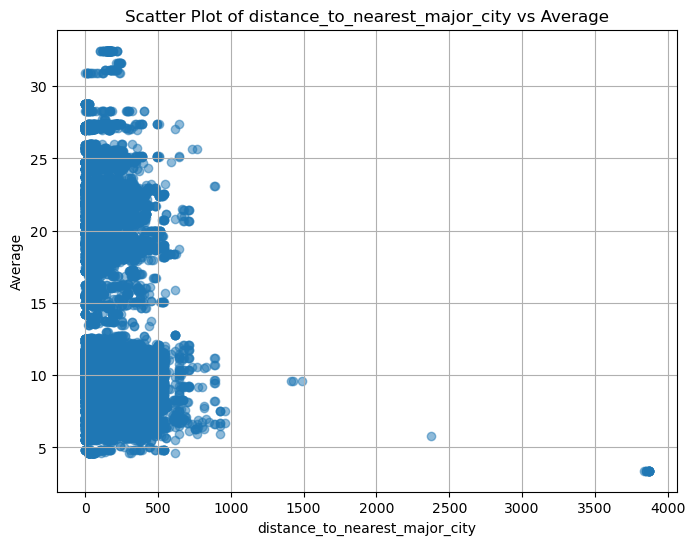

In [13]:
plot_scatter(df_modeling, "distance_to_nearest_major_city", "Average")

In [15]:
df_modeling['log_distance_to_major_city'] = np.log1p(df_modeling["distance_to_nearest_major_city"])

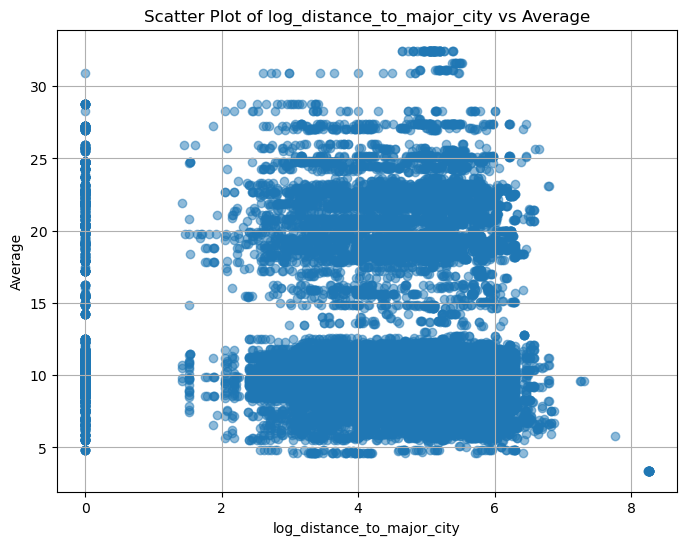

In [16]:
plot_scatter(df_modeling, 'log_distance_to_major_city', "Average")

In [17]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df_modeling['normalized_distance_to_major_city'] = scaler.fit_transform(df_modeling[["distance_to_nearest_major_city"]])

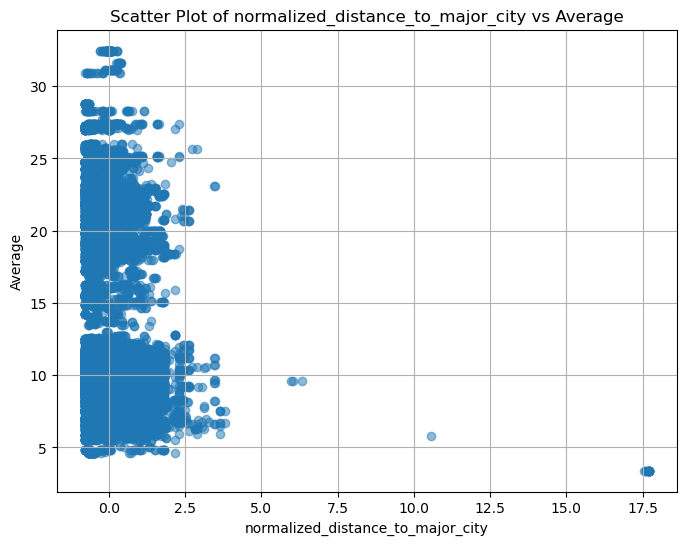

In [18]:
plot_scatter(df_modeling, 'normalized_distance_to_major_city', "Average")

In [19]:
df_modeling['log_normailized_distance_to_major_city'] = np.log1p(df_modeling["normalized_distance_to_major_city"])

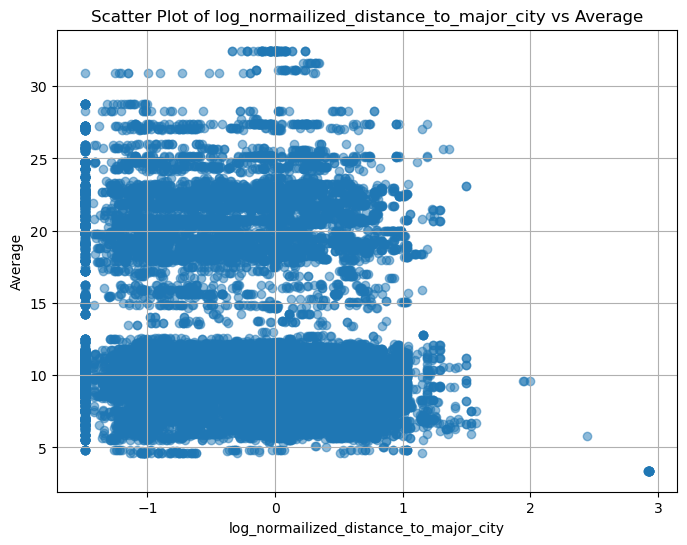

In [21]:
plot_scatter(df_modeling, 'log_normailized_distance_to_major_city', "Average")

In [22]:
df_modeling['log_distance_to_coast'] = np.log1p(df_modeling["distance_to_coast"])

In [27]:
df_modeling.fillna(0, inplace=True)

In [28]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score

X= df_modeling[["is_major_city","log_distance_to_major_city", "log_distance_to_coast",	"BIOCO2","CH4", "CO2", "HFC","HFE", "N2O",	"NF3",	"PFC", "SF6"]]
Y=df_modeling[['Average', 'Counts','Percent']]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [29]:
model = LinearRegression()

model.fit(X_train, y_train)

LinearRegression()

In [30]:
predictions = model.predict(X_test)

# Evaluating the model
mse = mean_squared_error(y_test, predictions)
r2 = r2_score(y_test, predictions)

print(f"Predictions: {predictions}")
print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

Predictions: [[ 1.21890289e+01  3.22077671e+06  1.76578394e-01]
 [ 1.15658364e+01  7.29192121e+05  1.70326035e-01]
 [ 1.09400217e+01 -1.49292354e+06  1.26109766e-01]
 ...
 [ 1.09947058e+01 -1.43380022e+06  1.30438520e-01]
 [ 1.20928850e+01  6.54992289e+06  2.70088096e-01]
 [ 1.16257431e+01  1.31408515e+06  1.62517374e-01]]
Mean Squared Error: 167188456104963.22
R^2 Score: 0.014556361180431798


Really bad results so want to see whats happening 

In [36]:
df_modeling.apply(lambda x: (x!=0).sum())

is_major_city                              2556
distance_to_nearest_major_city            28697
distance_to_coast                         31253
BIOCO2                                     3212
CH4                                       30307
CO2                                       27119
HFC                                         339
HFE                                         109
N2O                                       24533
NF3                                         264
OTHER                                        69
OTHER_FULL                                  323
PFC                                         408
SF6                                         799
VERY_SHORT                                  189
Average                                   30436
Counts                                    16088
Percent                                    4110
log_distance_to_major_city                28697
normalized_distance_to_major_city         31253
log_normailized_distance_to_major_city  

In [37]:
X= df_modeling[["is_major_city","log_distance_to_major_city", "log_distance_to_coast",	"BIOCO2","CH4", "CO2", "N2O"]]
Y=df_modeling[['Average', 'Counts']]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

In [38]:
model2 = LinearRegression()

model2.fit(X_train, y_train)

predictions = model2.predict(X_test)

# Evaluating the model
mse = mean_squared_error(y_test, predictions)
r2 = r2_score(y_test, predictions)

print(f"Predictions: {predictions}")
print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

Predictions: [[ 1.21876655e+01  3.15266488e+06]
 [ 1.15729238e+01  1.61465964e+06]
 [ 1.09415311e+01 -1.50377663e+06]
 ...
 [ 1.09960358e+01 -1.44783348e+06]
 [ 1.20916844e+01  6.50640614e+06]
 [ 1.16256455e+01  1.27295075e+06]]
Mean Squared Error: 250811627660196.62
R^2 Score: 0.018939000207230494


decided to drop alot of our gases and only keep the ones we had most information for

In [40]:
X= df_modeling[["distance_to_nearest_major_city", "distance_to_coast",	"BIOCO2","CH4", "CO2", "N2O"]]
Y=df_modeling[['Average']]
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

model3 = LinearRegression()

model3.fit(X_train, y_train)

predictions = model3.predict(X_test)
mse = mean_squared_error(y_test, predictions)
r2 = r2_score(y_test, predictions)

print(f"Predictions: {predictions}")
print(f"Mean Squared Error: {mse}")
print(f"R^2 Score: {r2}")

Predictions: [[12.05139422]
 [11.88056082]
 [10.45279379]
 ...
 [10.61246514]
 [12.54368241]
 [11.74597946]]
Mean Squared Error: 29.596899083656115
R^2 Score: 0.01687346920105315


Better but not good lets keep get a good one 

# A model that predicts air quality values based on emissions.

In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn import linear_model as lm

In [48]:
# import CSV data into dataframe
aq_with_emissions_by_county_with_na = pd.read_csv('csv_data/airquality_w_emmision_bycounty.csv')
aq_with_emissions_by_county = aq_with_emissions_by_county_with_na.dropna()
aq_with_emissions_by_county.tail()

,distance_to_nearest_major_city,distance_to_coast,Facility ID,BIOCO2,CH4,CO2,HFC,HFE,N2O,NF3,OTHER,OTHER_FULL,PFC,SF6,VERY_SHORT,CountyFips,StateFips,Average,Counts,Percent
1169,558875.469175,751266.227143,1.003700e+06,0.0000,9002.400000,305827.88000,0.0,0.0,182.37600,0.0,0.0,0.0,0.0,0.0,0.0,48501.0,48.0,7.799913,0.0,0.000000
1170,20118.185002,50257.650828,1.006065e+06,78.2750,9423.875000,25362.72500,0.0,0.0,6037.85250,0.0,0.0,0.0,0.0,0.0,0.0,6113.0,6.0,17.361437,3473037.0,4.160669
1171,102698.721456,216765.610333,1.003712e+06,148111.5125,13438.890625,759711.37875,0.0,0.0,5846.05225,0.0,0.0,0.0,0.0,0.0,0.0,38527.8,38.4,12.359189,1098232.0,0.000000
1172,61501.010585,109736.637604,1.004852e+06,0.0000,91538.625000,0.00000,0.0,0.0,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,6115.0,6.0,8.900070,580532.0,1.095890
1173,217798.766156,343258.204334,1.005425e+06,0.0000,27559.778680,64701.74000,0.0,0.0,36.53480,0.0,0.0,0.0,0.0,0.0,0.0,6076.0,6.0,10.954348,1009255.0,0.000000


In [49]:
aq_with_emissions_by_county.columns.values

array(['distance_to_nearest_major_city', 'distance_to_coast',
       'Facility ID', 'BIOCO2', 'CH4', 'CO2', 'HFC', 'HFE', 'N2O', 'NF3',
       'OTHER', 'OTHER_FULL', 'PFC', 'SF6', 'VERY_SHORT', 'CountyFips',
       'StateFips', 'Average', 'Counts', 'Percent'], dtype=object)

Let's check the number of 0s in each column. I don't want to use a column with mostly 0s as a feature, so the model does not think that the presence of a 0 is indicative of air quality measures (when it is more likely a missing or unreported value)

In [50]:
# check number of 0s in each column. Don't use columns with
number_of_zeros = (aq_with_emissions_by_county['VERY_SHORT'] == 0).sum()

print(f"The number of zeros in the column is: {number_of_zeros}")

The number of zeros in the column is: 1056


Check correlations or columns with air quality average.

In [51]:
aq_vs_distance_to_nearest_major_city = aq_with_emissions_by_county['Average'].corr(aq_with_emissions_by_county['distance_to_nearest_major_city'])
aq_vs_distance_to_coast = aq_with_emissions_by_county['Average'].corr(aq_with_emissions_by_county['distance_to_coast'])

aq_vs_distance_to_nearest_major_city
aq_vs_distance_to_coast

-0.20071692505149386

In [52]:
np.random.seed(133)

def train_val_split(data):
    """ 
    Takes in a DataFrame `data` and randomly splits it into two smaller DataFrames 
    named `train` and `validation` with 80% and 20% of the data, respectively. 
    """
    
    data_len = data.shape[0]
    shuffled_indices = np.random.permutation(data_len)
    
    split_index = int(0.8*data_len)
    train = data.iloc[shuffled_indices[:split_index]]
    validation = data.iloc[shuffled_indices[split_index:]]
   
    return train, validation

In [57]:
# log transform averages
aq_with_emissions_by_county.loc[:, 'Log Average'] = np.log(aq_with_emissions_by_county['Average'])
# pick features
feature_columns = [0, 1, 4, 5, 8]
features = aq_with_emissions_by_county.iloc[:, feature_columns]
features.head()
# split features and labels into training and validation
aq_values =  aq_with_emissions_by_county['Log Average']

# SPLIT INTO TRAINING AND VALIDATION
train_X, val_X = train_val_split(features)
train_y, val_y = train_val_split(aq_values)

Now let's create the model and make predictions.

In [58]:
model = lm.LinearRegression()
model.fit(train_X, train_y)
y_hat = model.predict(train_X)

In [59]:
def rmse(predicted, actual):
    """
    Calculates RMSE from actual and predicted values.
    Input:
      predicted (1D array): Vector of predicted/fitted values
      actual (1D array): Vector of actual values
    Output:
      A float, the RMSE value.
    """
    return np.sqrt(np.mean((actual - predicted)**2))

print(f'RMSE for model 1 is {rmse(y_hat, train_y)}')

RMSE for model 1 is 0.33983213890720376


In [1]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error


import punch_party_utils

In [2]:
air_quality_df = punch_party_utils.make_average_aq_df()
average_air_quality = air_quality_df[air_quality_df["MeasureName"] == "Annual average ambient concentrations of PM2.5 in micrograms per cubic meter (based on seasonal averages and daily measurement)"]


# For the first model, just CO2 emmisions in a given year -> air quality in a given year
air_quality_df = air_quality_df.drop(
    columns=["MeasureId", "MeasureName", "MeasureType", "StratificationLevel",
             "StateFips", "StateName", "CountyFips", "Unit",
             "UnitName", "DataOrigin", "MonitorOnly"])

# air_quality_df = air_quality_df.drop("CountyName")

In [3]:
# Add a column "County_Year" That will be used to join our air_quality and gas_types dataframes.
air_quality_df["County_Year"] = air_quality_df["CountyName"] + "_" + air_quality_df["ReportYear"].astype(str)

In [4]:
# This data & susequent plot for average air quality measurements over year led to some follow up modelling about facilities counts.
print(len(air_quality_df))

aq_year_only = air_quality_df.drop(columns=["CountyName", "County_Year"])
display(aq_year_only.columns)
aq_by_year = aq_year_only.groupby("ReportYear")

print ("\n")

air_quality_yearly_averages = aq_by_year.agg("mean")
print(air_quality_yearly_averages)

42621


Index(['ReportYear', 'Value'], dtype='object')



                Value
ReportYear           
1999        13.748994
2000        13.020075
2001        11.958253
2002        11.235081
2003        11.194532
2004        10.966340
2005        11.737703
2006        10.923896
2007        11.301560
2008        10.335900
2009         9.430018
2010         9.596560
2011         9.372181
2012         9.063382
2013         8.821925


In [5]:
gas_types = punch_party_utils.make_gas_types_df()

# Only keep the columns from gas_types that is useful in our gas types -> air quality model.
gas_types = gas_types.drop(
    columns=["Address Line 1", "City", 
             "Facility ID", "Gas Code", "Latitude", "Longitude", 
             "State Name", "Zip Code", "Facility Name"])

gas_types["County_Year"] = gas_types["County"] + "_" + gas_types["Year"].astype(str)

display(gas_types.head())

,CO2 Emission,County,Gas Name,Year,County_Year
0,58024.000,BROWN,BIOGENIC CO2,2017,BROWN_2017
1,134.500,NEW,METHANE,2018,NEW_2018
2,6.854,SABINE,NITROUS OXIDE,2012,SABINE_2012
3,53562.000,WASHINGTON,METHANE,2017,WASHINGTON_2017
4,7635064.700,TRIMBLE,CARBON DIOXIDE,2018,TRIMBLE_2018


In [6]:
raw_emmisions_year_only = gas_types.drop(columns=["Gas Name", "County", "County_Year"])
yearly_raw_emmisions = raw_emmisions_year_only.groupby("Year").agg("sum")
print(yearly_raw_emmisions)

      CO2 Emission
Year              
2010  3.229325e+09
2011  3.333042e+09
2012  3.194602e+09
2013  3.210963e+09
2014  3.222917e+09
2015  3.078839e+09
2016  3.019157e+09
2017  2.947673e+09
2018  3.037238e+09
2019  2.898178e+09


<class 'pandas.core.frame.DataFrame'>


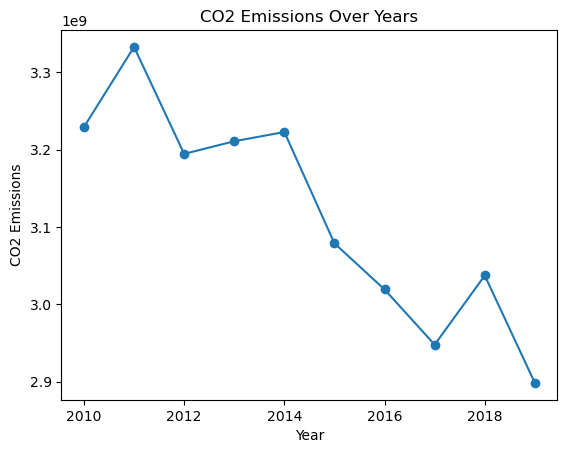

In [27]:
# Plot raw average CO2 Emissions year by year
print(type(yearly_raw_emmisions))

plt.plot(yearly_raw_emmisions.index, yearly_raw_emmisions['CO2 Emission'], marker='o')
plt.title('CO2 Emissions Over Years')
plt.xlabel('Year')
plt.ylabel('CO2 Emissions')
plt.savefig('CO2_emmisions_by_year.png')
plt.show()

In [7]:
# Join air quality and gas types dataframes, look at number of entries.
co2_emmisions_with_aq = yearly_raw_emmisions.merge(
    air_quality_yearly_averages, left_index=True, right_index=True, how="inner")
print(co2_emmisions_with_aq)

      CO2 Emission     Value
2010  3.229325e+09  9.596560
2011  3.333042e+09  9.372181
2012  3.194602e+09  9.063382
2013  3.210963e+09  8.821925


In [8]:
# Normalize with division by max
max_co2_emission = np.max(co2_emmisions_with_aq["CO2 Emission"])
max_co2_emission
co2_emmisions_with_aq["CO2 Emission"] = co2_emmisions_with_aq["CO2 Emission"] / max_co2_emission

display(co2_emmisions_with_aq)

,CO2 Emission,Value
2010,0.968882,9.596560
2011,1.000000,9.372181
2012,0.958464,9.063382
2013,0.963373,8.821925


In [9]:
# We had to look at finer-grained data than this because it only had 4 data points
# So ultimately we split up the data county-by-county to make our predictions.
# But we still were curious enough to make this (extremely sparse) model.
co2_aq_model = LinearRegression(fit_intercept=True)

independent_var = co2_emmisions_with_aq[["CO2 Emission"]]
dependent_var = co2_emmisions_with_aq["Value"]

display(independent_var)
display(dependent_var)

co2_aq_model.fit(independent_var, dependent_var)

,CO2 Emission
2010,0.968882
2011,1.000000
2012,0.958464
2013,0.963373


2010    9.596560
2011    9.372181
2012    9.063382
2013    8.821925
Name: Value, dtype: float64

LinearRegression()

In [10]:
# Divide value to predict by max emission from training for normalization consistency
value_to_predict = (3.2 * 10**9) / max_co2_emission

print(co2_aq_model.predict(np.array([value_to_predict]).reshape(-1, 1)))

[9.10959159]


/home/sean/miniconda3/envs/msse-python/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [11]:
# Now we look at the emissions values from individual gas types.
emissions_per_year_per_gas = gas_types.drop(columns=["County", "County_Year"]).groupby(['Year', 'Gas Name']).mean()

emissions_per_year_per_gas = emissions_per_year_per_gas.reset_index()

emissions_per_year_per_gas = emissions_per_year_per_gas.pivot(index='Year', columns='Gas Name', values='CO2 Emission').dropna()

display(emissions_per_year_per_gas.head())

Gas Name,BIOGENIC CO2,CARBON DIOXIDE,HFCS,HFES,METHANE,NITROGEN TRIFLOURIDE,NITROUS OXIDE,OTHER,OTHER FULLY FLUORINATED GHGS,PFCS,SULFUR HEXAFLUORIDE,VERY SHORT-LIVED COMPOUNDS
Year,,,,,,,,,,,,
2011,219854.886983,462302.634066,196118.872666,888.608834,31507.831677,22648.793747,6002.174766,6747.611722,28001.296085,113693.707661,34794.461450,7.803089
2012,221692.959997,428138.510385,153791.590090,680.194925,29956.920238,20703.412830,4755.363164,6425.133333,28315.847044,104668.101817,28516.478182,5.895594
2013,215409.963821,427731.424518,129820.451666,623.485861,29092.144228,16215.268148,4291.312665,5294.825375,32481.755893,103245.245113,27478.328136,8.221518
2014,211993.601611,420014.630570,121274.558525,1409.273671,28052.491027,15063.658824,4523.518900,4466.333333,27371.955091,93473.825614,27592.388072,13.654441
2015,214321.305711,405575.849913,100378.183108,4111.709119,28259.379143,16324.279200,4282.749662,4692.033333,25813.783808,87343.614173,24874.326846,10.037224


In [12]:
# Merge gas types emissions with our dataframe for air quality measurements to get our dependent variable into the dataframe.
all_gasses_with_air_quality = emissions_per_year_per_gas.merge(
    air_quality_yearly_averages, left_index=True, right_index=True, how="inner")
display(all_gasses_with_air_quality) 

,BIOGENIC CO2,CARBON DIOXIDE,HFCS,HFES,METHANE,NITROGEN TRIFLOURIDE,NITROUS OXIDE,OTHER,OTHER FULLY FLUORINATED GHGS,PFCS,SULFUR HEXAFLUORIDE,VERY SHORT-LIVED COMPOUNDS,Value
2011,219854.886983,462302.634066,196118.872666,888.608834,31507.831677,22648.793747,6002.174766,6747.611722,28001.296085,113693.707661,34794.461450,7.803089,9.372181
2012,221692.959997,428138.510385,153791.590090,680.194925,29956.920238,20703.412830,4755.363164,6425.133333,28315.847044,104668.101817,28516.478182,5.895594,9.063382
2013,215409.963821,427731.424518,129820.451666,623.485861,29092.144228,16215.268148,4291.312665,5294.825375,32481.755893,103245.245113,27478.328136,8.221518,8.821925


In [13]:
def model_air_quality_from_multiple_gasses(gasses, aq_values):
    """
    Create a model that can predict air quality from a design matrix of emissions of individual gas types.

    parameters
    ----------
    df : Dataframe
        A dataframe with an independent variable for each gas type we wish to use as a feature for air quality prediction.
    aq_values : Series
        A series representing the dependent variable to train on.

    returns
    -------
    A model that can predict air quality from a given input of gas types
    """
    model_with_gas_types = LinearRegression(fit_intercept=True)
    assert len(gasses) == len(aq_values), "Length of input dataframe does not equal length of output dataframe"

    model_with_gas_types.fit(gasses, aq_values)

    print("Intercept of the model:")
    print(model_with_gas_types.intercept_)
    print("\n")
    print("Features of the model:")
    print(gasses.columns.tolist())
    print("\n")
    print("Coefficients of the model:")
    print(model_with_gas_types.coef_)

    return model_with_gas_types

In [14]:
# Set up (normalized) design matrix & target values, and call model_with_gas_types.
all_gasses_per_year = all_gasses_with_air_quality.drop(columns=["Value"])
air_qualities_by_year = all_gasses_with_air_quality["Value"]
max_gas_emissions_per_year = all_gasses_per_year.max()
normalized_max_gas_emissions = all_gasses_per_year / max_gas_emissions_per_year
air_qualities_by_year = all_gasses_with_air_quality["Value"]

model_with_gas_types = model_air_quality_from_multiple_gasses(normalized_max_gas_emissions, air_qualities_by_year)

Intercept of the model:
7.520742140483977


Features of the model:
['BIOGENIC CO2', 'CARBON DIOXIDE', 'HFCS', 'HFES', 'METHANE', 'NITROGEN TRIFLOURIDE', 'NITROUS OXIDE', 'OTHER', 'OTHER FULLY FLUORINATED GHGS', 'PFCS', 'SULFUR HEXAFLUORIDE', 'VERY SHORT-LIVED COMPOUNDS']


Coefficients of the model:
[-1.12278356 -0.05521366 -0.80792737  2.27842992  1.35020234  0.68148472
 -0.08529045  0.05376891 -0.0440125   0.77360609 -0.96595478 -0.23206163]


In [15]:
# Run a sample prediction with normalized inputs.
example_value_to_predict = np.array([215409.963821, 427731.424518, 129820.451666, 623.485861, 29092.144228, 16215.268148, 4291.312665, 5294.825375, 32481.755893, 103245.245113, 27478.328136, 8.221518]).reshape(-1, 1)
max_gas_emissions = all_gasses_with_air_quality.drop(columns=["Value"]).max()
normalized_values_to_predict = example_value_to_predict / np.array(max_gas_emissions).reshape(-1, 1)
normalized_values_to_predict = normalized_values_to_predict.T

prediction = model_with_gas_types.predict(normalized_values_to_predict)
print(prediction)

[8.82192485]


/home/sean/miniconda3/envs/msse-python/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


In [16]:
# Now we do a similar modelling process as above with finer-grained data by looking at emission report averages of individual counties.
aq_county_year = air_quality_df.drop(columns=["CountyName", "ReportYear"])
display(aq_county_year.columns)
aq_county_year = aq_county_year.groupby("County_Year")

print ("\n")

air_quality_county_yearly_averages = aq_county_year.agg("mean")
print(air_quality_county_yearly_averages)

Index(['Value', 'County_Year'], dtype='object')



                    Value
County_Year              
ABBEVILLE_2001  14.211375
ABBEVILLE_2002  13.130120
ABBEVILLE_2003  13.184619
ABBEVILLE_2004  13.725566
ABBEVILLE_2005  14.178854
...                   ...
ZIEBACH_2007     6.366442
ZIEBACH_2008     6.497561
ZIEBACH_2009     6.901008
ZIEBACH_2010     6.692292
ZIEBACH_2011     6.230142

[21562 rows x 1 columns]


In [17]:
print(gas_types)
raw_emmisions_county_year = gas_types.drop(columns=["Gas Name", "County", "Year"])
county_yearly_raw_emmisions = raw_emmisions_county_year.groupby("County_Year").agg("sum")
print(county_yearly_raw_emmisions)

        CO2 Emission      County        Gas Name  Year      County_Year
0          58024.000       BROWN    BIOGENIC CO2  2017       BROWN_2017
1            134.500         NEW         METHANE  2018         NEW_2018
2              6.854      SABINE   NITROUS OXIDE  2012      SABINE_2012
3          53562.000  WASHINGTON         METHANE  2017  WASHINGTON_2017
4        7635064.700     TRIMBLE  CARBON DIOXIDE  2018     TRIMBLE_2018
...              ...         ...             ...   ...              ...
219922    301493.000      SKAGIT    BIOGENIC CO2  2016      SKAGIT_2016
219923      1929.800      SKAGIT  CARBON DIOXIDE  2016      SKAGIT_2016
219924      2776.500    GUILFORD  CARBON DIOXIDE  2018    GUILFORD_2018
219926        23.840    BRADFORD   NITROUS OXIDE  2012    BRADFORD_2012
219927        23.000    BRADFORD         METHANE  2013    BRADFORD_2013

[203601 rows x 5 columns]
             CO2 Emission
County_Year              
ACADIA_2010   1448577.425
ACADIA_2011   1572541.979
ACADI

In [18]:
county_year_only = gas_types.drop(columns=["Year", "County"])

In [19]:
# Create a dataframe that will serve as our design matrix.

emissions_per_county_year_per_gas = county_year_only.groupby(['County_Year', 'Gas Name']).mean()

emissions_per_county_year_per_gas = emissions_per_county_year_per_gas.reset_index()

emissions_per_county_year_per_gas = emissions_per_county_year_per_gas.pivot(index='County_Year', columns='Gas Name', values='CO2 Emission')

# Counting NaNs per column
# nan_count = emissions_per_county_year_per_gas.isna().sum()
# print(nan_count)

# The following gasses have NaN in over 10000 of the ~12000 rows of the emissions_per_county_year_per_gas dataframe, dropping these columns before modelling.
gasses_with_insufficient_measurements = ["HFCS", "HFES", "NITROGEN TRIFLOURIDE", "OTHER", "OTHER FULLY FLUORINATED GHGS", "PFCS", "SULFUR HEXAFLUORIDE", "VERY SHORT-LIVED COMPOUNDS"]

display(len(emissions_per_county_year_per_gas))
emissions_per_county_year_per_gas = emissions_per_county_year_per_gas.drop(columns=gasses_with_insufficient_measurements).dropna()
display(len(emissions_per_county_year_per_gas))

display(emissions_per_county_year_per_gas.head())

11730

4156

Gas Name,BIOGENIC CO2,CARBON DIOXIDE,METHANE,NITROUS OXIDE
County_Year,,,,
ADAMS_2015,338.5,9.461366e+05,13728.293478,5257.448444
ADAMS_2016,26.6,1.064286e+06,13979.718750,5353.520333
ADAMS_2018,11.9,5.177267e+05,13150.250000,1727.270737
ADAMS_2019,11.9,4.123245e+05,13830.102273,893.368941
ADA_2015,12206.1,1.331350e+04,56095.500000,85.675000


In [20]:
# Add the target dependent variables to our dataframe.
gasses_with_air_quality_and_counties = emissions_per_county_year_per_gas.merge(
    air_quality_county_yearly_averages, left_index=True, right_index=True, how="inner")
display(gasses_with_air_quality_and_counties) 
display(len(gasses_with_air_quality_and_counties)) 

,BIOGENIC CO2,CARBON DIOXIDE,METHANE,NITROUS OXIDE,Value
County_Year,,,,,
AIKEN_2010,16171.000000,444627.100000,18422.875000,1329.974000,12.340038
AIKEN_2011,10549.000000,429155.266667,18827.562500,1191.851000,12.658858
ALACHUA_2013,64093.800000,317543.266667,495.250000,918.883000,6.914032
ALAMEDA_2010,49073.996479,38720.705363,63579.865362,100.483415,8.442426
ALAMEDA_2011,50407.739015,29260.805667,59862.691017,98.726208,10.494480
...,...,...,...,...,...
YOLO_2013,69.900000,32644.566667,9132.125000,3400.676667,7.495000
YORK_2010,397115.233333,886716.105333,14722.633333,7798.018154,10.287617
YORK_2011,338540.600000,715022.474118,12648.367647,6235.789067,10.299324


1156

In [21]:
# Separate our design matrix & target values, then call "model_air_quality_from_multiple_gasses" to make a model for predicting.
gasses_with_air_quality_per_year_and_county = gasses_with_air_quality_and_counties.drop(columns=["Value"])
max_gas_emissions_by_county = gasses_with_air_quality_per_year_and_county.max()
normalized_max_gas_emissions_by_county = gasses_with_air_quality_per_year_and_county / max_gas_emissions_by_county
air_qualities_by_year_and_county = gasses_with_air_quality_and_counties["Value"]

x_train, x_test, y_train, y_test = train_test_split(normalized_max_gas_emissions_by_county, air_qualities_by_year_and_county)

model_with_counties_and_gas_types = model_air_quality_from_multiple_gasses(x_train, y_train)

Intercept of the model:
9.52210153191177


Features of the model:
['BIOGENIC CO2', 'CARBON DIOXIDE', 'METHANE', 'NITROUS OXIDE']


Coefficients of the model:
[-0.12875852  1.22941789 -0.25566719 -2.17853407]


In [22]:
# Make an example prediction.
example_point_to_predict = np.array([16171.000000, 444627.100000, 18422.875000, 1329.974000]).reshape(-1, 1)

max_gas_emissions_per_county_per_year = gasses_with_air_quality_and_counties.drop(columns=["Value"]).max()
normalized_values_to_predict = example_point_to_predict / np.array(max_gas_emissions_by_county).reshape(-1, 1)
normalized_values_to_predict = normalized_values_to_predict.T

prediction = model_with_counties_and_gas_types.predict(normalized_values_to_predict)
print(prediction)

[9.57063165]


/home/sean/miniconda3/envs/msse-python/lib/python3.11/site-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but LinearRegression was fitted with feature names
  warnings.warn(


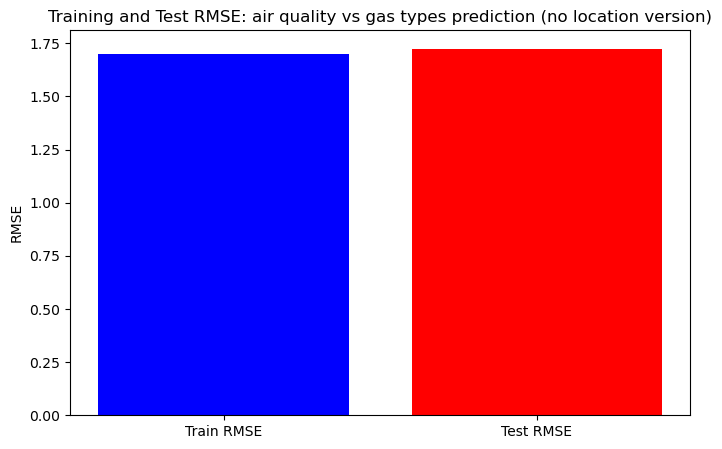

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

<Figure size 640x480 with 0 Axes>

In [24]:
# Plot RMSE for finer-grained model.

y_train_pred_county_year =  model_with_counties_and_gas_types.predict(x_train)
y_test_pred_county_year =  model_with_counties_and_gas_types.predict(x_test)

rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred_county_year))
rmse_test = np.sqrt(mean_squared_error(y_test, y_test_pred_county_year))

plt.figure(figsize=(8, 5))
plt.bar(['Train RMSE', 'Test RMSE'], [rmse_train, rmse_test], color=['blue', 'red'])
plt.ylabel('RMSE')
plt.title('Training and Test RMSE: air quality vs gas types prediction (no location version)')
plt.show()
plt.savefig("rmse_quality_vs_gas_county_predictions.png")

plt.figure()

In [95]:
import matplotlib.pyplot as plt
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression

import punch_party_utils


In [87]:
# The subsequent model tries to answer the question: are facilities per state trending up or down, and how much does this vary state-by-state?

facilities_df = punch_party_utils.make_facilities_df()

columns_relevant_to_question = ["State Name", "Year"]
facilities_df = facilities_df[columns_relevant_to_question]

display(facilities_df.head())

/home/sean/msse/data200S/TeamPunchParty/punch_party_utils.py:19: DtypeWarning: Columns (1) have mixed types. Specify dtype option on import or set low_memory=False.
  facilities_df = pd.read_csv(filename)


,State Name,Year
0,TEXAS,2012.0
1,LOUISIANA,2011.0
2,TENNESSEE,2017.0
3,FLORIDA,2015.0
5,GEORGIA,2011.0


In [88]:
# Make a dataframe with the Years as the feature and the count of number of facilities, which we plan to predict.

facilities_with_counts = facilities_df.groupby(columns_relevant_to_question).value_counts()

facilities_by_state_by_year_df = facilities_with_counts.reset_index()

# Show Alabama as an example.
display(facilities_by_state_by_year_df[facilities_by_state_by_year_df["State Name"] == "ALABAMA"])

,State Name,Year,count
0,ALABAMA,2010.0,153
1,ALABAMA,2011.0,167
2,ALABAMA,2012.0,175
3,ALABAMA,2013.0,176
4,ALABAMA,2014.0,178
5,ALABAMA,2015.0,176
6,ALABAMA,2016.0,175
7,ALABAMA,2017.0,175
8,ALABAMA,2018.0,175
9,ALABAMA,2019.0,170


In [89]:
# We will call this function once for each state to make a predictive model that takes in year as input and predicts # of facilities in that state.

def make_model_for_state(state_facilities_counts):
    state_facilities_counts = state_facilities_counts.sort_values(by=["Year"])
    y_values = state_facilities_counts["count"]
    x_values = np.array(state_facilities_counts["Year"]).reshape(-1, 1)
    # Perform Scaler normalization (subtract mean and divide by variance.)
    scalar = StandardScaler()
    x_values = scalar.fit_transform(x_values)
    model = LinearRegression()
    model.fit(x_values, y_values)
    return model, scalar


In [90]:
# Make a model for each state.
state_models = {}
for state in np.unique(facilities_by_state_by_year_df["State Name"]):
    model, scalar = make_model_for_state(facilities_by_state_by_year_df[facilities_by_state_by_year_df["State Name"] == state])
    state_models[state] = (model, scalar)

# display(state_models)

In [94]:
predictions= {}

# Predict number of facilities in each state for the year 2050
for state in state_models.keys():
    (model, scalar) = state_models[state]
    prediction_year = np.array([2050]).reshape(-1, 1)
    prediction_year_normalized = scalar.transform(prediction_year)
    predictions[state] = np.round(model.predict(prediction_year_normalized))

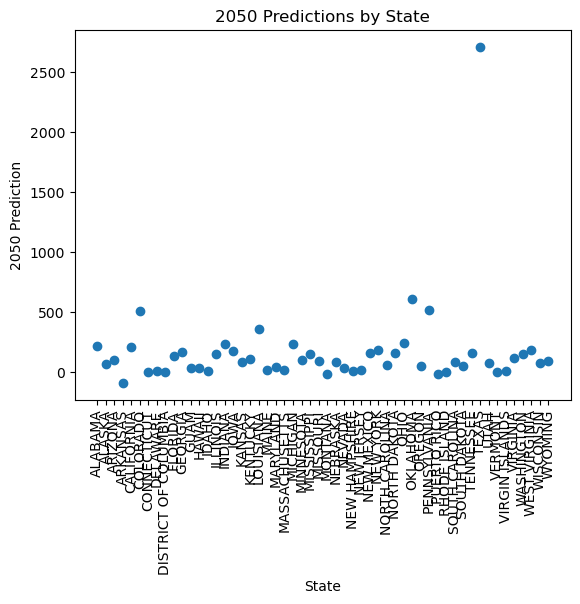

<Figure size 640x480 with 0 Axes>

In [109]:
# Plot the prediction for number of facilities for each state in the year 2050.
states = list(predictions.keys())
prediction_values = [pred[0] for pred in predictions.values()]

plt.figure(figsize = (20, 8))

# Creating the scatter plot
plt.scatter(states, prediction_values)
plt.xlabel('State')
plt.ylabel('2050 Prediction')
plt.title('2050 Predictions by State')
plt.xticks(rotation=90)
plt.show()

plt.savefig("2050_predictions.png")

In [103]:
# Look at the outlier.
print(facilities_by_state_by_year_df[facilities_by_state_by_year_df["State Name"] == "TEXAS"])

    State Name    Year  count
450      TEXAS  2010.0    592
451      TEXAS  2011.0    861
452      TEXAS  2012.0    926
453      TEXAS  2013.0    934
454      TEXAS  2014.0    990
455      TEXAS  2015.0    991
456      TEXAS  2016.0   1075
457      TEXAS  2017.0   1098
458      TEXAS  2018.0   1130
459      TEXAS  2019.0   1136


In [102]:
print(predictions["TEXAS"])

[2708.]
